<a href="https://colab.research.google.com/github/Arifanalysis/Fabric-class/blob/main/LSTM_CNN_Model_new_dataset.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# First, verify that GPU is enabled
import tensorflow as tf
import torch
import subprocess

def verify_gpu_setup():
    print("=== Checking GPU Availability ===\n")

    # Check NVIDIA GPU details
    print("NVIDIA GPU Details:")
    !nvidia-smi
    print("\n")

    # Check PyTorch GPU availability
    print("PyTorch GPU Status:")
    print(f"PyTorch CUDA Available: {torch.cuda.is_available()}")
    if torch.cuda.is_available():
        print(f"Current GPU Device: {torch.cuda.get_device_name()}")
        print(f"Device Count: {torch.cuda.device_count()}")
    print("\n")

    # Check TensorFlow GPU availability
    print("TensorFlow GPU Status:")
    print(f"TensorFlow GPU Devices: {tf.config.list_physical_devices('GPU')}")

verify_gpu_setup()

# Example of using GPU with PyTorch
def pytorch_gpu_example():
    # Create a tensor and move it to GPU
    x = torch.tensor([1., 2., 3.])
    if torch.cuda.is_available():
        x = x.cuda()
        print("Tensor successfully moved to GPU:", x.device)
    else:
        print("GPU not available")

# Example of using GPU with TensorFlow
def tensorflow_gpu_example():
    # Create a simple computation on GPU
    with tf.device('/GPU:0'):
        a = tf.constant([[1.0, 2.0, 3.0], [4.0, 5.0, 6.0]])
        b = tf.constant([[1.0, 2.0], [3.0, 4.0], [5.0, 6.0]])
        c = tf.matmul(a, b)
        print("Matrix multiplication result:", c)

=== Checking GPU Availability ===

NVIDIA GPU Details:
/bin/bash: line 1: nvidia-smi: command not found


PyTorch GPU Status:
PyTorch CUDA Available: False


TensorFlow GPU Status:
TensorFlow GPU Devices: []


In [ ]:
! pip install kaggle
! mkdir ~/.kaggle
! cp kaggle.json ~/.kaggle/
! chmod 600 ~/.kaggle/kaggle.json
! kaggle datasets download -d sobouhiarif/fdd-new-augmented
#kaggle datasets download -d sobouhiarif/fabric-defect-test

Dataset URL: https://www.kaggle.com/datasets/sobouhiarif/fdd-new-augmented
License(s): unknown
100% 2.23G/2.23G [00:30<00:00, 91.6MB/s]
100% 2.23G/2.23G [00:30<00:00, 78.1MB/s]


In [ ]:
from google.colab import auth
auth.authenticate_user()
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("sobouhiarif/fdd-new-augmented")

print("Path to dataset files:", path)

100%|██████████| 2.23G/2.23G [00:23<00:00, 101MB/s]

Extracting files...


Path to dataset files: /root/.cache/kagglehub/datasets/sobouhiarif/fdd-new-augmented/versions/1


In [ ]:
! unzip /content/fdd-new-augmented.zip

Streaming output truncated to the last 5000 lines.
  inflating: FDD Classification Augmantation new/Train/Knitted/Gray/broken thread/WIN_20241028_19_14_16_Pro.jpg  
  inflating: FDD Classification Augmantation new/Train/Knitted/Gray/broken thread/WIN_20241028_19_14_20_Pro.jpg  
  inflating: FDD Classification Augmantation new/Train/Knitted/Gray/broken thread/WIN_20241028_19_14_26_Pro.jpg  
  inflating: FDD Classification Augmantation new/Train/Knitted/Gray/broken thread/WIN_20241028_19_14_43_Pro.jpg  
  inflating: FDD Classification Augmantation new/Train/Knitted/Gray/broken thread/WIN_20241028_19_15_35_Pro.jpg  
  inflating: FDD Classification Augmantation new/Train/Knitted/Gray/broken thread/WIN_20241028_19_15_49_Pro.jpg  
  inflating: FDD Classification Augmantation new/Train/Knitted/Gray/broken thread/WIN_20241028_19_26_04_Pro.jpg  
  inflating: FDD Classification Augmantation new/Train/Knitted/Gray/broken thread/WIN_20241028_19_26_08_Pro.jpg  
  inflating: FDD Classification Augma

In [ ]:
from google.colab import files
import shutil
folder_path = "/content/FDD Classification Augmantation new"
zip_file_path = "/content/fdd-new-augmented.zip"
shutil.make_archive(zip_file_path[:-4], 'zip', folder_path)

'/content/fdd-new-augmented.zip'

In [ ]:
import zipfile

# Specify the path to the zip file
zip_file_path = '/content/fdd-new-augmented.zip'

# Specify the directory where you want to extract the contents
extract_path = '/content/FDD Classification Augmantation new'

# Unzip the folder
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    zip_ref.extractall(extract_path)

Image counts per category: {'stain': 200, 'damage': 200, 'broken thread': 200, 'holes': 200, 'non defective': 200}
Shape of trainX: (800, 784, 3)
Shape of testX: (200, 784, 3)
Shape of trainY: (800, 5)
Shape of testY: (200, 5)


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ lstm_1 (LSTM)                        │ (None, 784, 128)            │          67,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 784, 128)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv1d_1 (Conv1D)                    │ (None, 784, 64)             │          24,640 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_1                │ (None, 784, 64)             │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling1d_1 (MaxPooling1D)       │ (None, 392, 64)             │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_1 (Flatten)                  │ (None, 25088)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 5)                   │         125,445 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 217,925 (851.27 KB)

 Trainable params: 217,797 (850.77 KB)

 Non-trainable params: 128 (512.00 B)

None
Epoch 1/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 29s 1s/step - accuracy: 0.2707 - loss: 3.7295 - val_accuracy: 0.1950 - val_loss: 2.5469 - learning_rate: 0.0010
Epoch 2/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 49s 1s/step - accuracy: 0.3114 - loss: 2.5104 - val_accuracy: 0.2200 - val_loss: 2.4989 - learning_rate: 0.0010
Epoch 3/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 32s 1s/step - accuracy: 0.3510 - loss: 2.3729 - val_accuracy: 0.2400 - val_loss: 2.4435 - learning_rate: 0.0010
Epoch 4/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 48s 1s/step - accuracy: 0.3879 - loss: 2.2538 - val_accuracy: 0.3000 - val_loss: 2.3787 - learning_rate: 0.0010
Epoch 5/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 27s 1s/step - accuracy: 0.3782 - loss: 2.2205 - val_accuracy: 0.3150 - val_loss: 2.3111 - learning_rate: 0.0010
Epoch 6/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 41s 1s/step - accuracy: 0.4119 - loss: 2.0828 - val_accuracy: 0.2650 - val_loss: 2.2836 - learning_rate: 0.0010
Epoch 7/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 42s 1s/step - accuracy: 0.4544 - loss: 1.9826 - val_accur

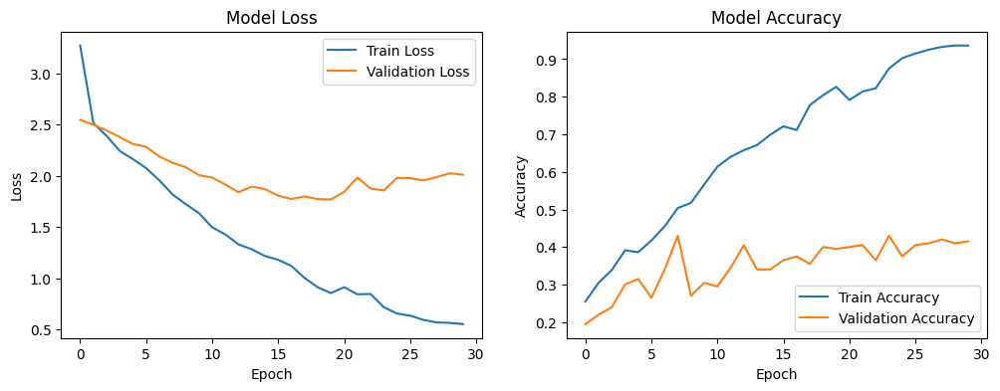

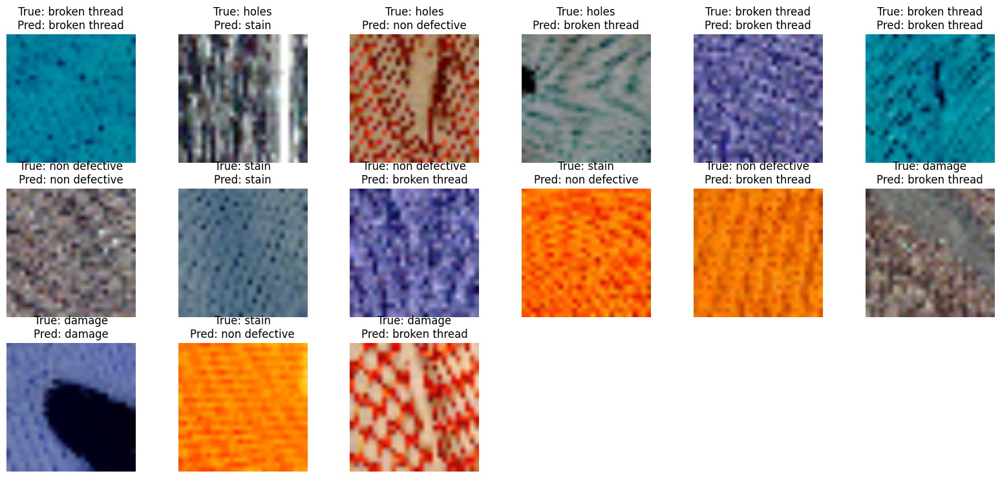

In [ ]:
#LSTM-CNN model
import os
import cv2
import numpy as np
import time
from keras.models import Sequential
from keras.layers import LSTM, Dense, Dropout, Flatten, Conv1D, MaxPooling1D, BatchNormalization
from keras.utils import to_categorical
from keras.callbacks import ReduceLROnPlateau, EarlyStopping
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, f1_score
import matplotlib.pyplot as plt

# Function to load the Kaggle image dataset in .jpg format
def load_dataset():
    base_dir = '/content/FDD Classification Augmantation new/Train/Knitted/Dyed'
    categories = ['stain', 'damage', 'broken thread', 'holes', 'non defective']
    images = []
    labels = []
    category_counts = {category: 0 for category in categories}
    # To track the number of images per category

    for label, category in enumerate(categories):
        category_dir = os.path.join(base_dir, category)
        if not os.path.exists(category_dir):
            print(f"Directory {category_dir} does not exist. Skipping this category.")
            continue
        for filename in os.listdir(category_dir):
            if filename.endswith('.jpg'):
                img = cv2.imread(os.path.join(category_dir, filename))
                img = cv2.resize(img, (28, 28))  # Resize image to 28x28
                images.append(img)
                labels.append(label)
                category_counts[category] += 1  # Count the images for each category

    images = np.array(images)
    labels = np.array(labels)

    print("Image counts per category:", category_counts)  # Print the counts for debugging

    return images, labels, categories

# Load the Kaggle image dataset
images, labels, categories = load_dataset()

if len(images) == 0:
    raise ValueError("No images found. Please check the dataset path and ensure images are available.")

# Preprocess the images (normalize pixel values)
images = images.astype('float32') / 255.0

# Convert labels to one-hot encoding
labels = to_categorical(labels, num_classes=len(categories))

# Reshape images for LSTM input (assuming each image is treated as a sequence of pixels)
images = images.reshape(images.shape[0], -1, images.shape[3])  # Adjust to (batch_size, sequence_length, feature_dim)

# Split the dataset into training and test sets
trainX, testX, trainY, testY = train_test_split(images, labels, test_size=0.2, random_state=42)

# Verify shapes of trainX, testX, trainY, testY
print("Shape of trainX:", trainX.shape)
print("Shape of testX:", testX.shape)
print("Shape of trainY:", trainY.shape)
print("Shape of testY:", testY.shape)

# Define the single LSTM-CNN model
model = Sequential()
model.add(LSTM(128, input_shape=(trainX.shape[1], trainX.shape[2]), return_sequences=True))
model.add(Dropout(0.5))


# Ensure the input dimension is compatible with Conv1D
model.add(Conv1D(64, 3, activation='relu', padding='same', kernel_regularizer='l2'))
model.add(BatchNormalization())
model.add(MaxPooling1D(2))

# Flatten and add the output layer
model.add(Flatten())
model.add(Dense(len(categories), activation='softmax', kernel_regularizer='l2'))

# Compile the model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Print model summary
print(model.summary())

# Callbacks for learning rate reduction and early stopping
lr_reduction = ReduceLROnPlateau(monitor='val_loss', patience=3, verbose=1, factor=0.5, min_lr=0.000001)
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# Train the model
start_time = time.time()
history = model.fit(trainX, trainY, epochs=90, batch_size=32, validation_data=(testX, testY), callbacks=[lr_reduction, early_stopping], verbose=1)
end_time = time.time()

# Evaluate the model
loss, accuracy = model.evaluate(testX, testY, verbose=0)
print('Test Loss:', loss)
print('Test Accuracy:', accuracy)

# Get predictions for the test set
predY = model.predict(testX)
predY_classes = np.argmax(predY, axis=1)
trueY_classes = np.argmax(testY, axis=1)

# Ensure we only use labels present in the test set
unique_true_labels = np.unique(trueY_classes)

# Print classification report
class_report = classification_report(
    trueY_classes, predY_classes,
    target_names=[categories[i] for i in unique_true_labels],
    output_dict=True,
    zero_division=0
)
print(class_report)

# Print confusion matrix
conf_matrix = confusion_matrix(trueY_classes, predY_classes)
print(conf_matrix)

# Calculate and print additional metrics
accuracy_scores = accuracy_score(trueY_classes, predY_classes)
f1_scores = f1_score(trueY_classes, predY_classes, average=None)

print("Accuracy Scores: ", accuracy_scores)
print("F1 Scores: ", f1_scores)
print("Average F1 Score: ", np.mean(f1_scores))

# Calculate and display accuracy for each category
category_accuracies = {}
for i, category in enumerate(categories):
    category_mask = (trueY_classes == i)
    category_correct = (predY_classes[category_mask] == i).sum()
    category_total = category_mask.sum()
    category_accuracies[category] = category_correct / category_total
    print(f"Accuracy for {category}: {category_accuracies[category]:.2f}")

print(f"Total Training Time: {end_time - start_time} seconds")

# Plot training & validation loss and accuracy values
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper right')

plt.subplot(1, 2, 2)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')

plt.show()

# Visualize test images with improved pixel quality and ensure class representation
plt.figure(figsize=(20, 15))

# Dictionary to track how many images have been displayed per class
displayed_count = {category: 0 for category in categories}

# Maximum number of images to display per class
max_images_per_class = 3

displayed_images = 0
for i in range(len(testX)):
    true_label = categories[trueY_classes[i]]
    if displayed_count[true_label] < max_images_per_class:
        plt.subplot(5, 6, displayed_images + 1)  # Adjusting the grid for 18 images
        resized_image = cv2.resize(testX[i].reshape(28, 28, 3), (128, 128))  # Rescale for better quality
        plt.imshow(resized_image)
        plt.title(f"True: {true_label}\nPred: {categories[predY_classes[i]]}")
        plt.axis('off')

        displayed_count[true_label] += 1
        displayed_images += 1

    # Break the loop after displaying 18 images (3 images per class, 6 classes)
    if displayed_images >= max_images_per_class * len(categories):
        break

plt.show()


In [ ]:
# Save the trained model in .h5 format for Raspberry Pi
model.save('/content/model_defect_detection.h5')
print("Model saved in .h5 format.")


Model saved in .h5 format.


Model loaded successfully.
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/ste

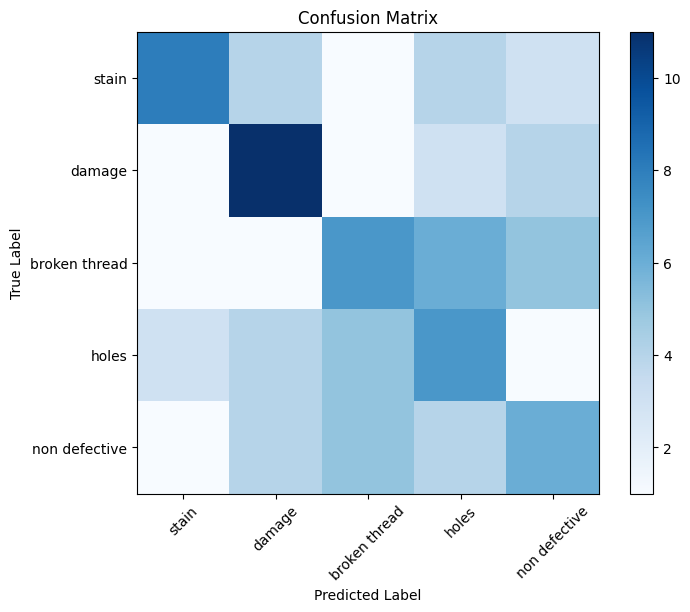

Loading image: /content/FDD Classification Augmantation new/Test/Knitted/Dyed/stain/WIN_20240720_12_38_39_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Knitted/Dyed/stain/WIN_20241029_15_53_38_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Knitted/Dyed/stain/WIN_20241029_16_00_06_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Knitted/Dyed/damage/WIN_20241029_13_25_51_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Knitted/Dyed/damage/WIN_20241029_15_57_32_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Knitted/Dyed/damage/WIN_20241029_17_13_56_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Knitted/Dyed/broken thread/WIN_20241028_22_14_20_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Knitted/Dyed/broken thread/WIN_20241029_15_54_18_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Knit

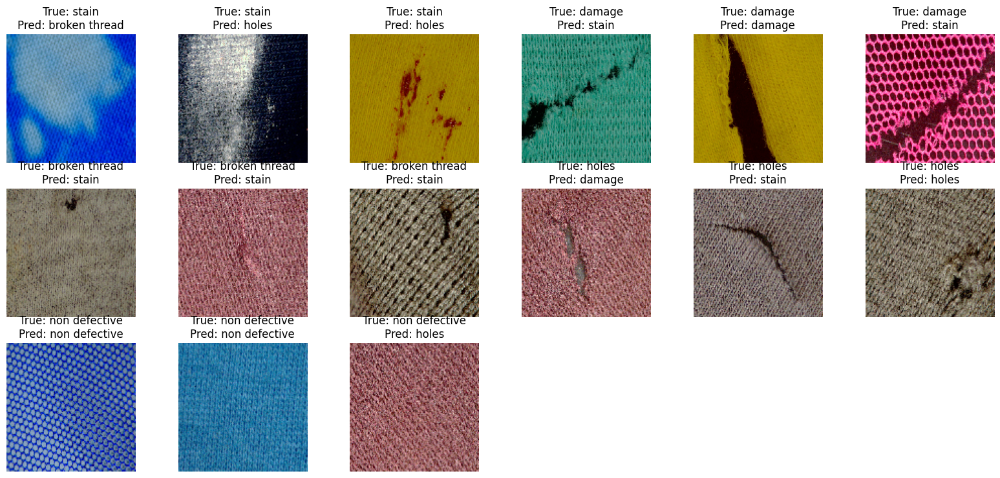

In [ ]:
import cv2
import numpy as np
from keras.models import load_model
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, f1_score
import matplotlib.pyplot as plt
import os

# Load the saved model
model_path = '/content/model_defect_detection.h5'
model = load_model(model_path)
print("Model loaded successfully.")

# Define categories and initialize lists to track true and predicted labels
categories = ['stain', 'damage', 'broken thread', 'holes', 'non defective']
true_labels = []
predicted_labels = []

# Function to preprocess and predict on a single image
def predict_defect(image_path):
    img = cv2.imread(image_path)
    img = cv2.resize(img, (28, 28))  # Resize to 28x28 pixels
    img = img.astype('float32') / 255.0  # Normalize
    img = img.reshape(1, -1, img.shape[2])  # Reshape for LSTM input

    # Predict the defect class
    prediction = model.predict(img)
    predicted_class = np.argmax(prediction, axis=1)[0]
    return predicted_class

# Load and predict on new test dataset
test_dir = '/content/FDD Classification Augmantation new/Test/Knitted/Dyed'
for category_index, category in enumerate(categories):
    category_path = os.path.join(test_dir, category)
    if not os.path.exists(category_path):
        print(f"Directory {category_path} does not exist. Skipping.")
        continue

    for img_file in os.listdir(category_path):
        img_path = os.path.join(category_path, img_file)
        if img_file.endswith('.jpg'):
            pred_label = predict_defect(img_path)
            true_labels.append(category_index)
            predicted_labels.append(pred_label)

# Get unique classes from the true and predicted labels
unique_labels = np.unique(np.concatenate((true_labels, predicted_labels)))

# Classification Report and Metrics
print("\nClassification Report:")
class_report = classification_report(
    true_labels,
    predicted_labels,
    labels=unique_labels,  # Use the unique labels
    target_names=categories,
    output_dict=True,
    zero_division=0
)

print(class_report)


# Confusion Matrix
conf_matrix = confusion_matrix(true_labels, predicted_labels)
print("\nConfusion Matrix:\n", conf_matrix)

# Class-Specific Accuracy
category_accuracies = {}
for i, category in enumerate(categories):
    mask = (np.array(true_labels) == i)
    correct_predictions = (np.array(predicted_labels)[mask] == i).sum()
    category_accuracies[category] = correct_predictions / mask.sum() if mask.sum() > 0 else 0
    print(f"Accuracy for {category}: {category_accuracies[category]:.2f}")

# Calculate overall metrics
accuracy_scores = accuracy_score(true_labels, predicted_labels)
f1_scores = f1_score(true_labels, predicted_labels, average=None)
print("\nOverall Accuracy Score: ", accuracy_scores)
print("F1 Scores: ", f1_scores)
print("Average F1 Score: ", np.mean(f1_scores))

# Plot Confusion Matrix
plt.figure(figsize=(8, 6))
plt.imshow(conf_matrix, interpolation='nearest', cmap=plt.cm.Blues)
plt.title("Confusion Matrix")
plt.colorbar()
plt.xticks(np.arange(len(categories)), categories, rotation=45)
plt.yticks(np.arange(len(categories)), categories)
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

# Display sample images with true and predicted labels (3 images per category)
plt.figure(figsize=(20, 15))
displayed_count = {category: 0 for category in categories}
max_images_per_class = 3
displayed_images = 0

# Loop over the categories to display images
for category_index, category in enumerate(categories):
    category_path = os.path.join(test_dir, category)
    if not os.path.exists(category_path):
        print(f"Directory {category_path} does not exist. Skipping.")
        continue

    for img_file in os.listdir(category_path):
        if displayed_count[category] < max_images_per_class and img_file.endswith('.jpg'):
            img_path = os.path.join(category_path, img_file)
            print(f"Loading image: {img_path}")  # Print the image path for debugging
            img = cv2.imread(img_path)

            # Check if the image was loaded successfully
            if img is not None:
                img = cv2.resize(img, (128, 128))  # Resize for better display quality
                plt.subplot(5, 6, displayed_images + 1)
                plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB
                plt.title(f"True: {category}\nPred: {categories[predicted_labels[displayed_images]]}")
                plt.axis('off')

                displayed_count[category] += 1
                displayed_images += 1

                # Stop after showing 3 images per category
                if displayed_images >= max_images_per_class * len(categories):
                    break
            else:
                print(f"Warning: Image at path '{img_path}' could not be loaded.")  # Print a warning if the image fails to load

plt.show()


Image counts per category: {'stain': 200, 'damage': 200, 'broken thread': 200, 'holes': 200, 'non defective': 200}
Shape of trainX: (800, 784, 3)
Shape of testX: (200, 784, 3)
Shape of trainY: (800, 5)
Shape of testY: (200, 5)


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ lstm_2 (LSTM)                        │ (None, 784, 128)            │          67,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_2 (Dropout)                  │ (None, 784, 128)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv1d_2 (Conv1D)                    │ (None, 784, 64)             │          24,640 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_2                │ (None, 784, 64)             │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling1d_2 (MaxPooling1D)       │ (None, 392, 64)             │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_2 (Flatten)                  │ (None, 25088)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 5)                   │         125,445 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 217,925 (851.27 KB)

 Trainable params: 217,797 (850.77 KB)

 Non-trainable params: 128 (512.00 B)

None
Epoch 1/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 44s 2s/step - accuracy: 0.2561 - loss: 3.4768 - val_accuracy: 0.2500 - val_loss: 2.5182 - learning_rate: 0.0010
Epoch 2/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 31s 1s/step - accuracy: 0.4497 - loss: 2.1841 - val_accuracy: 0.2800 - val_loss: 2.4310 - learning_rate: 0.0010
Epoch 3/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 33s 1s/step - accuracy: 0.4403 - loss: 2.0894 - val_accuracy: 0.4300 - val_loss: 2.3515 - learning_rate: 0.0010
Epoch 4/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 27s 1s/step - accuracy: 0.5829 - loss: 1.8214 - val_accuracy: 0.3350 - val_loss: 2.2796 - learning_rate: 0.0010
Epoch 5/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 25s 1s/step - accuracy: 0.5716 - loss: 1.7687 - val_accuracy: 0.3100 - val_loss: 2.1865 - learning_rate: 0.0010
Epoch 6/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 40s 974ms/step - accuracy: 0.6251 - loss: 1.6051 - val_accuracy: 0.3900 - val_loss: 2.0965 - learning_rate: 0.0010
Epoch 7/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 26s 1s/step - accuracy: 0.6287 - loss: 1.5102 - val_ac

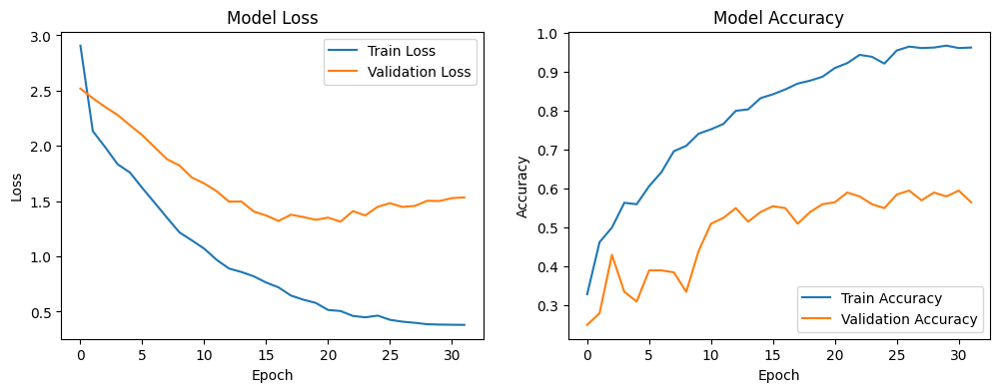

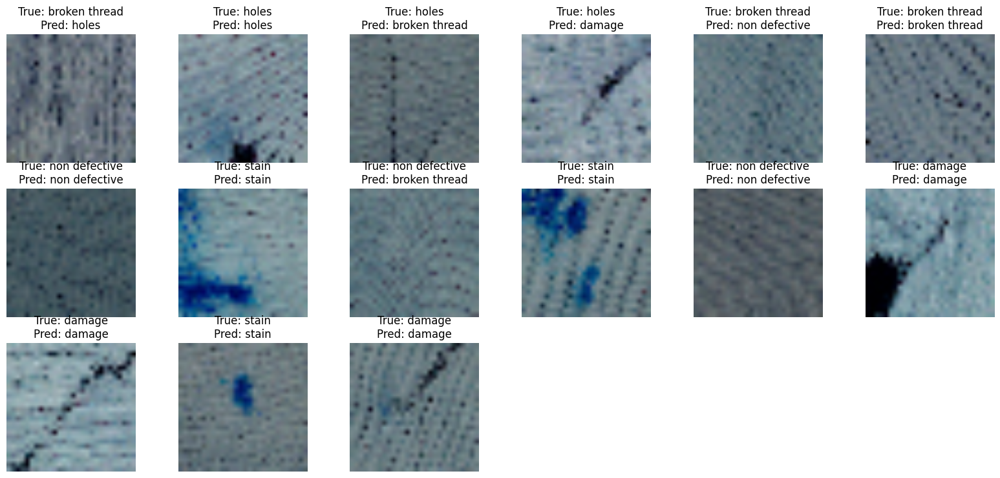

In [ ]:
#LSTM-CNN model
import os
import cv2
import numpy as np
import time
from keras.models import Sequential
from keras.layers import LSTM, Dense, Dropout, Flatten, Conv1D, MaxPooling1D, BatchNormalization
from keras.utils import to_categorical
from keras.callbacks import ReduceLROnPlateau, EarlyStopping
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, f1_score
import matplotlib.pyplot as plt

# Function to load the Kaggle image dataset in .jpg format
def load_dataset():
    base_dir = '/content/FDD Classification Augmantation new/Train/Knitted/Gray'
    categories = ['stain', 'damage', 'broken thread', 'holes', 'non defective']
    images = []
    labels = []
    category_counts = {category: 0 for category in categories}
    # To track the number of images per category

    for label, category in enumerate(categories):
        category_dir = os.path.join(base_dir, category)
        if not os.path.exists(category_dir):
            print(f"Directory {category_dir} does not exist. Skipping this category.")
            continue
        for filename in os.listdir(category_dir):
            if filename.endswith('.jpg'):
                img = cv2.imread(os.path.join(category_dir, filename))
                img = cv2.resize(img, (28, 28))  # Resize image to 28x28
                images.append(img)
                labels.append(label)
                category_counts[category] += 1  # Count the images for each category

    images = np.array(images)
    labels = np.array(labels)

    print("Image counts per category:", category_counts)  # Print the counts for debugging

    return images, labels, categories

# Load the Kaggle image dataset
images, labels, categories = load_dataset()

if len(images) == 0:
    raise ValueError("No images found. Please check the dataset path and ensure images are available.")

# Preprocess the images (normalize pixel values)
images = images.astype('float32') / 255.0

# Convert labels to one-hot encoding
labels = to_categorical(labels, num_classes=len(categories))

# Reshape images for LSTM input (assuming each image is treated as a sequence of pixels)
images = images.reshape(images.shape[0], -1, images.shape[3])  # Adjust to (batch_size, sequence_length, feature_dim)

# Split the dataset into training and test sets
trainX, testX, trainY, testY = train_test_split(images, labels, test_size=0.2, random_state=42)

# Verify shapes of trainX, testX, trainY, testY
print("Shape of trainX:", trainX.shape)
print("Shape of testX:", testX.shape)
print("Shape of trainY:", trainY.shape)
print("Shape of testY:", testY.shape)

# Define the single LSTM-CNN model
model = Sequential()
model.add(LSTM(128, input_shape=(trainX.shape[1], trainX.shape[2]), return_sequences=True))
model.add(Dropout(0.5))


# Ensure the input dimension is compatible with Conv1D
model.add(Conv1D(64, 3, activation='relu', padding='same', kernel_regularizer='l2'))
model.add(BatchNormalization())
model.add(MaxPooling1D(2))

# Flatten and add the output layer
model.add(Flatten())
model.add(Dense(len(categories), activation='softmax', kernel_regularizer='l2'))

# Compile the model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Print model summary
print(model.summary())

# Callbacks for learning rate reduction and early stopping
lr_reduction = ReduceLROnPlateau(monitor='val_loss', patience=3, verbose=1, factor=0.5, min_lr=0.000001)
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# Train the model
start_time = time.time()
history = model.fit(trainX, trainY, epochs=90, batch_size=32, validation_data=(testX, testY), callbacks=[lr_reduction, early_stopping], verbose=1)
end_time = time.time()

# Evaluate the model
loss, accuracy = model.evaluate(testX, testY, verbose=0)
print('Test Loss:', loss)
print('Test Accuracy:', accuracy)

# Get predictions for the test set
predY = model.predict(testX)
predY_classes = np.argmax(predY, axis=1)
trueY_classes = np.argmax(testY, axis=1)

# Ensure we only use labels present in the test set
unique_true_labels = np.unique(trueY_classes)

# Print classification report
class_report = classification_report(
    trueY_classes, predY_classes,
    target_names=[categories[i] for i in unique_true_labels],
    output_dict=True,
    zero_division=0
)
print(class_report)

# Print confusion matrix
conf_matrix = confusion_matrix(trueY_classes, predY_classes)
print(conf_matrix)

# Calculate and print additional metrics
accuracy_scores = accuracy_score(trueY_classes, predY_classes)
f1_scores = f1_score(trueY_classes, predY_classes, average=None)

print("Accuracy Scores: ", accuracy_scores)
print("F1 Scores: ", f1_scores)
print("Average F1 Score: ", np.mean(f1_scores))

# Calculate and display accuracy for each category
category_accuracies = {}
for i, category in enumerate(categories):
    category_mask = (trueY_classes == i)
    category_correct = (predY_classes[category_mask] == i).sum()
    category_total = category_mask.sum()
    category_accuracies[category] = category_correct / category_total
    print(f"Accuracy for {category}: {category_accuracies[category]:.2f}")

print(f"Total Training Time: {end_time - start_time} seconds")

# Plot training & validation loss and accuracy values
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper right')

plt.subplot(1, 2, 2)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')

plt.show()

# Visualize test images with improved pixel quality and ensure class representation
plt.figure(figsize=(20, 15))

# Dictionary to track how many images have been displayed per class
displayed_count = {category: 0 for category in categories}

# Maximum number of images to display per class
max_images_per_class = 3

displayed_images = 0
for i in range(len(testX)):
    true_label = categories[trueY_classes[i]]
    if displayed_count[true_label] < max_images_per_class:
        plt.subplot(5, 6, displayed_images + 1)  # Adjusting the grid for 18 images
        resized_image = cv2.resize(testX[i].reshape(28, 28, 3), (128, 128))  # Rescale for better quality
        plt.imshow(resized_image)
        plt.title(f"True: {true_label}\nPred: {categories[predY_classes[i]]}")
        plt.axis('off')

        displayed_count[true_label] += 1
        displayed_images += 1

    # Break the loop after displaying 18 images (3 images per class, 6 classes)
    if displayed_images >= max_images_per_class * len(categories):
        break

plt.show()


In [ ]:
# Save the trained model in .h5 format for Raspberry Pi
model.save('/content/model_knitted_Gray.h5')
print("Model saved in .h5 format.")


Model saved in .h5 format.


Model loaded successfully.
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 707ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/ste

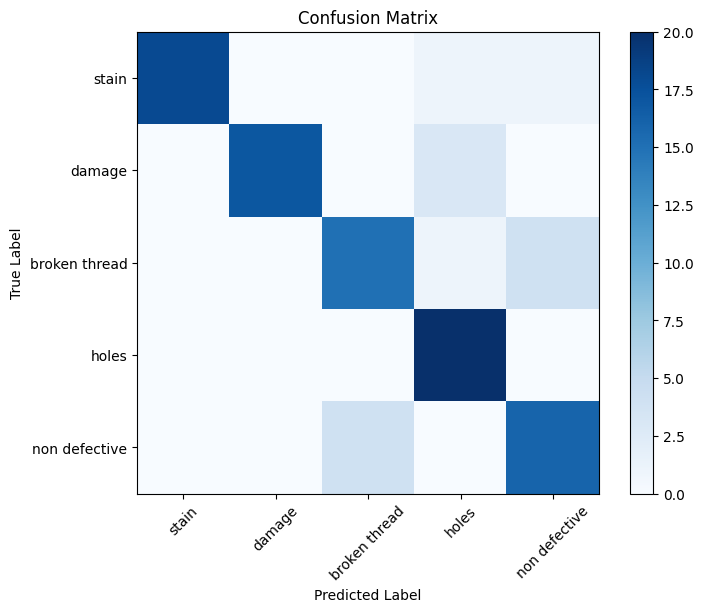

Loading image: /content/FDD Classification Augmantation new/Test/Knitted/Gray/stain/WIN_20241028_19_31_08_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Knitted/Gray/stain/WIN_20241028_21_30_36_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Knitted/Gray/stain/WIN_20241028_21_39_29_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Knitted/Gray/damage/WIN_20241028_19_16_56_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Knitted/Gray/damage/WIN_20241028_21_26_57_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Knitted/Gray/damage/WIN_20241028_20_13_08_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Knitted/Gray/broken thread/WIN_20241028_19_14_16_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Knitted/Gray/broken thread/WIN_20241028_21_36_46_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Knit

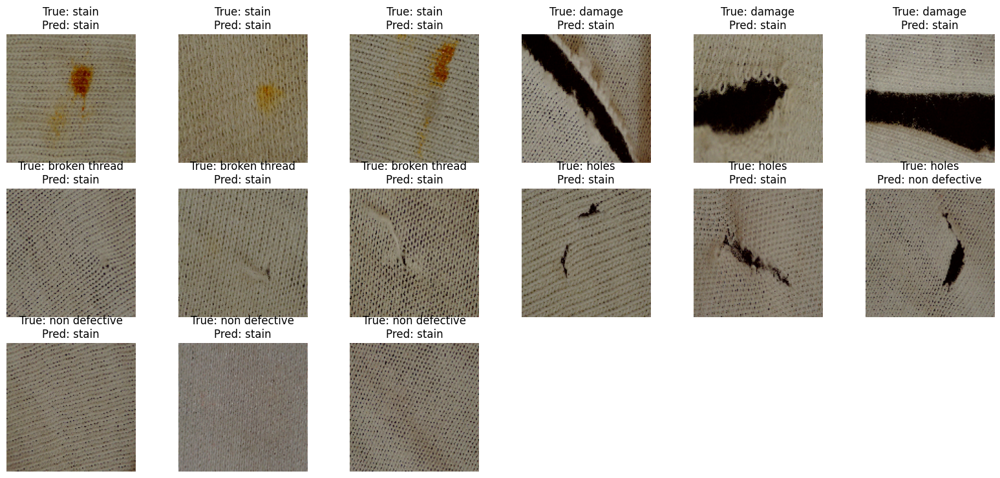

In [ ]:
import cv2
import numpy as np
from keras.models import load_model
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, f1_score
import matplotlib.pyplot as plt
import os

# Load the saved model
model_path = '/content/model_knitted_Gray.h5'
model = load_model(model_path)
print("Model loaded successfully.")

# Define categories and initialize lists to track true and predicted labels
categories = ['stain', 'damage', 'broken thread', 'holes', 'non defective']
true_labels = []
predicted_labels = []

# Function to preprocess and predict on a single image
def predict_defect(image_path):
    img = cv2.imread(image_path)
    img = cv2.resize(img, (28, 28))  # Resize to 28x28 pixels
    img = img.astype('float32') / 255.0  # Normalize
    img = img.reshape(1, -1, img.shape[2])  # Reshape for LSTM input

    # Predict the defect class
    prediction = model.predict(img)
    predicted_class = np.argmax(prediction, axis=1)[0]
    return predicted_class

# Load and predict on new test dataset
test_dir = '/content/FDD Classification Augmantation new/Test/Knitted/Gray'
for category_index, category in enumerate(categories):
    category_path = os.path.join(test_dir, category)
    if not os.path.exists(category_path):
        print(f"Directory {category_path} does not exist. Skipping.")
        continue

    for img_file in os.listdir(category_path):
        img_path = os.path.join(category_path, img_file)
        if img_file.endswith('.jpg'):
            pred_label = predict_defect(img_path)
            true_labels.append(category_index)
            predicted_labels.append(pred_label)

# Get unique classes from the true and predicted labels
unique_labels = np.unique(np.concatenate((true_labels, predicted_labels)))

# Classification Report and Metrics
print("\nClassification Report:")
class_report = classification_report(
    true_labels,
    predicted_labels,
    labels=unique_labels,  # Use the unique labels
    target_names=categories,
    output_dict=True,
    zero_division=0
)

print(class_report)


# Confusion Matrix
conf_matrix = confusion_matrix(true_labels, predicted_labels)
print("\nConfusion Matrix:\n", conf_matrix)

# Class-Specific Accuracy
category_accuracies = {}
for i, category in enumerate(categories):
    mask = (np.array(true_labels) == i)
    correct_predictions = (np.array(predicted_labels)[mask] == i).sum()
    category_accuracies[category] = correct_predictions / mask.sum() if mask.sum() > 0 else 0
    print(f"Accuracy for {category}: {category_accuracies[category]:.2f}")

# Calculate overall metrics
accuracy_scores = accuracy_score(true_labels, predicted_labels)
f1_scores = f1_score(true_labels, predicted_labels, average=None)
print("\nOverall Accuracy Score: ", accuracy_scores)
print("F1 Scores: ", f1_scores)
print("Average F1 Score: ", np.mean(f1_scores))

# Plot Confusion Matrix
plt.figure(figsize=(8, 6))
plt.imshow(conf_matrix, interpolation='nearest', cmap=plt.cm.Blues)
plt.title("Confusion Matrix")
plt.colorbar()
plt.xticks(np.arange(len(categories)), categories, rotation=45)
plt.yticks(np.arange(len(categories)), categories)
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

# Display sample images with true and predicted labels (3 images per category)
plt.figure(figsize=(20, 15))
displayed_count = {category: 0 for category in categories}
max_images_per_class = 3
displayed_images = 0

# Loop over the categories to display images
for category_index, category in enumerate(categories):
    category_path = os.path.join(test_dir, category)
    if not os.path.exists(category_path):
        print(f"Directory {category_path} does not exist. Skipping.")
        continue

    for img_file in os.listdir(category_path):
        if displayed_count[category] < max_images_per_class and img_file.endswith('.jpg'):
            img_path = os.path.join(category_path, img_file)
            print(f"Loading image: {img_path}")  # Print the image path for debugging
            img = cv2.imread(img_path)

            # Check if the image was loaded successfully
            if img is not None:
                img = cv2.resize(img, (128, 128))  # Resize for better display quality
                plt.subplot(5, 6, displayed_images + 1)
                plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB
                plt.title(f"True: {category}\nPred: {categories[predicted_labels[displayed_images]]}")
                plt.axis('off')

                displayed_count[category] += 1
                displayed_images += 1

                # Stop after showing 3 images per category
                if displayed_images >= max_images_per_class * len(categories):
                    break
            else:
                print(f"Warning: Image at path '{img_path}' could not be loaded.")  # Print a warning if the image fails to load

plt.show()


Image counts per category: {'stain': 200, 'damage': 200, 'broken thread': 200, 'holes': 200, 'non defective': 200}
Shape of trainX: (800, 784, 3)
Shape of testX: (200, 784, 3)
Shape of trainY: (800, 5)
Shape of testY: (200, 5)


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ lstm_3 (LSTM)                        │ (None, 784, 128)            │          67,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_3 (Dropout)                  │ (None, 784, 128)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv1d_3 (Conv1D)                    │ (None, 784, 64)             │          24,640 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_3                │ (None, 784, 64)             │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling1d_3 (MaxPooling1D)       │ (None, 392, 64)             │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_3 (Flatten)                  │ (None, 25088)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 5)                   │         125,445 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 217,925 (851.27 KB)

 Trainable params: 217,797 (850.77 KB)

 Non-trainable params: 128 (512.00 B)

None
Epoch 1/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 45s 2s/step - accuracy: 0.2058 - loss: 4.1876 - val_accuracy: 0.1650 - val_loss: 2.5603 - learning_rate: 0.0010
Epoch 2/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 47s 2s/step - accuracy: 0.3383 - loss: 2.3982 - val_accuracy: 0.1650 - val_loss: 2.5082 - learning_rate: 0.0010
Epoch 3/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 59s 982ms/step - accuracy: 0.4155 - loss: 2.2667 - val_accuracy: 0.1650 - val_loss: 2.4449 - learning_rate: 0.0010
Epoch 4/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 41s 971ms/step - accuracy: 0.4445 - loss: 2.1747 - val_accuracy: 0.1650 - val_loss: 2.3616 - learning_rate: 0.0010
Epoch 5/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 42s 1s/step - accuracy: 0.4930 - loss: 1.9911 - val_accuracy: 0.1800 - val_loss: 2.3148 - learning_rate: 0.0010
Epoch 6/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 42s 1s/step - accuracy: 0.4770 - loss: 1.8991 - val_accuracy: 0.2100 - val_loss: 2.2483 - learning_rate: 0.0010
Epoch 7/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 24s 966ms/step - accuracy: 0.5457 - loss: 1.7211 - 

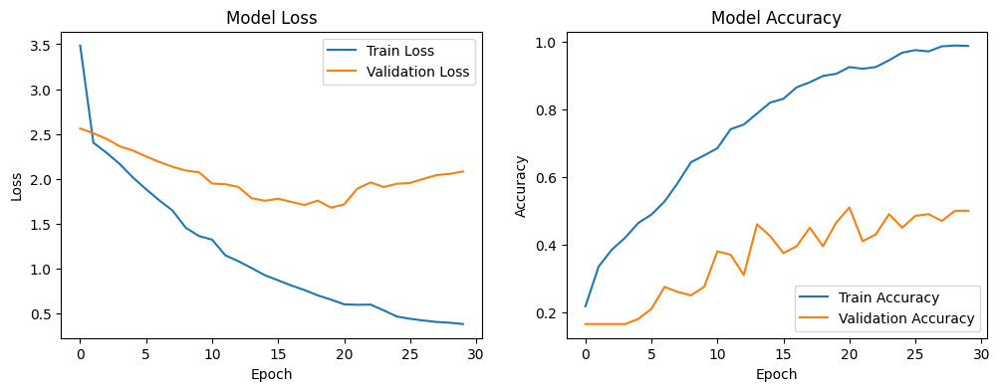

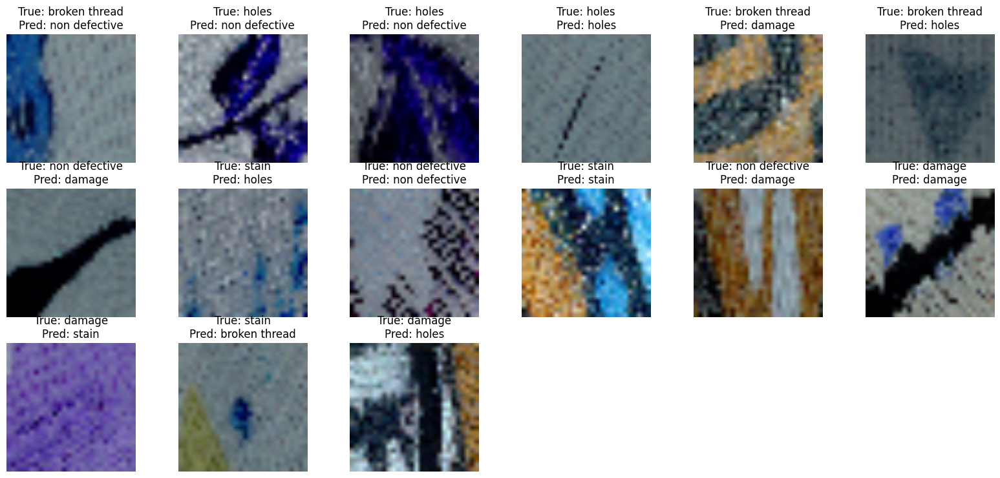

In [ ]:
#LSTM-CNN model
import os
import cv2
import numpy as np
import time
from keras.models import Sequential
from keras.layers import LSTM, Dense, Dropout, Flatten, Conv1D, MaxPooling1D, BatchNormalization
from keras.utils import to_categorical
from keras.callbacks import ReduceLROnPlateau, EarlyStopping
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, f1_score
import matplotlib.pyplot as plt

# Function to load the Kaggle image dataset in .jpg format
def load_dataset():
    base_dir = '/content/FDD Classification Augmantation new/Train/Knitted/Printed'
    categories = ['stain', 'damage', 'broken thread', 'holes', 'non defective']
    images = []
    labels = []
    category_counts = {category: 0 for category in categories}
    # To track the number of images per category

    for label, category in enumerate(categories):
        category_dir = os.path.join(base_dir, category)
        if not os.path.exists(category_dir):
            print(f"Directory {category_dir} does not exist. Skipping this category.")
            continue
        for filename in os.listdir(category_dir):
            if filename.endswith('.jpg'):
                img = cv2.imread(os.path.join(category_dir, filename))
                img = cv2.resize(img, (28, 28))  # Resize image to 28x28
                images.append(img)
                labels.append(label)
                category_counts[category] += 1  # Count the images for each category

    images = np.array(images)
    labels = np.array(labels)

    print("Image counts per category:", category_counts)  # Print the counts for debugging

    return images, labels, categories

# Load the Kaggle image dataset
images, labels, categories = load_dataset()

if len(images) == 0:
    raise ValueError("No images found. Please check the dataset path and ensure images are available.")

# Preprocess the images (normalize pixel values)
images = images.astype('float32') / 255.0

# Convert labels to one-hot encoding
labels = to_categorical(labels, num_classes=len(categories))

# Reshape images for LSTM input (assuming each image is treated as a sequence of pixels)
images = images.reshape(images.shape[0], -1, images.shape[3])  # Adjust to (batch_size, sequence_length, feature_dim)

# Split the dataset into training and test sets
trainX, testX, trainY, testY = train_test_split(images, labels, test_size=0.2, random_state=42)

# Verify shapes of trainX, testX, trainY, testY
print("Shape of trainX:", trainX.shape)
print("Shape of testX:", testX.shape)
print("Shape of trainY:", trainY.shape)
print("Shape of testY:", testY.shape)

# Define the single LSTM-CNN model
model = Sequential()
model.add(LSTM(128, input_shape=(trainX.shape[1], trainX.shape[2]), return_sequences=True))
model.add(Dropout(0.5))


# Ensure the input dimension is compatible with Conv1D
model.add(Conv1D(64, 3, activation='relu', padding='same', kernel_regularizer='l2'))
model.add(BatchNormalization())
model.add(MaxPooling1D(2))

# Flatten and add the output layer
model.add(Flatten())
model.add(Dense(len(categories), activation='softmax', kernel_regularizer='l2'))

# Compile the model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Print model summary
print(model.summary())

# Callbacks for learning rate reduction and early stopping
lr_reduction = ReduceLROnPlateau(monitor='val_loss', patience=3, verbose=1, factor=0.5, min_lr=0.000001)
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# Train the model
start_time = time.time()
history = model.fit(trainX, trainY, epochs=90, batch_size=32, validation_data=(testX, testY), callbacks=[lr_reduction, early_stopping], verbose=1)
end_time = time.time()

# Evaluate the model
loss, accuracy = model.evaluate(testX, testY, verbose=0)
print('Test Loss:', loss)
print('Test Accuracy:', accuracy)

# Get predictions for the test set
predY = model.predict(testX)
predY_classes = np.argmax(predY, axis=1)
trueY_classes = np.argmax(testY, axis=1)

# Ensure we only use labels present in the test set
unique_true_labels = np.unique(trueY_classes)

# Print classification report
class_report = classification_report(
    trueY_classes, predY_classes,
    target_names=[categories[i] for i in unique_true_labels],
    output_dict=True,
    zero_division=0
)
print(class_report)

# Print confusion matrix
conf_matrix = confusion_matrix(trueY_classes, predY_classes)
print(conf_matrix)

# Calculate and print additional metrics
accuracy_scores = accuracy_score(trueY_classes, predY_classes)
f1_scores = f1_score(trueY_classes, predY_classes, average=None)

print("Accuracy Scores: ", accuracy_scores)
print("F1 Scores: ", f1_scores)
print("Average F1 Score: ", np.mean(f1_scores))

# Calculate and display accuracy for each category
category_accuracies = {}
for i, category in enumerate(categories):
    category_mask = (trueY_classes == i)
    category_correct = (predY_classes[category_mask] == i).sum()
    category_total = category_mask.sum()
    category_accuracies[category] = category_correct / category_total
    print(f"Accuracy for {category}: {category_accuracies[category]:.2f}")

print(f"Total Training Time: {end_time - start_time} seconds")

# Plot training & validation loss and accuracy values
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper right')

plt.subplot(1, 2, 2)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')

plt.show()

# Visualize test images with improved pixel quality and ensure class representation
plt.figure(figsize=(20, 15))

# Dictionary to track how many images have been displayed per class
displayed_count = {category: 0 for category in categories}

# Maximum number of images to display per class
max_images_per_class = 3

displayed_images = 0
for i in range(len(testX)):
    true_label = categories[trueY_classes[i]]
    if displayed_count[true_label] < max_images_per_class:
        plt.subplot(5, 6, displayed_images + 1)  # Adjusting the grid for 18 images
        resized_image = cv2.resize(testX[i].reshape(28, 28, 3), (128, 128))  # Rescale for better quality
        plt.imshow(resized_image)
        plt.title(f"True: {true_label}\nPred: {categories[predY_classes[i]]}")
        plt.axis('off')

        displayed_count[true_label] += 1
        displayed_images += 1

    # Break the loop after displaying 18 images (3 images per class, 6 classes)
    if displayed_images >= max_images_per_class * len(categories):
        break

plt.show()


In [ ]:
# Save the trained model in .h5 format for Raspberry Pi
model.save('/content/model_knitted_printed.h5')
print("Model saved in .h5 format.")


Model saved in .h5 format.


Model loaded successfully.
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/ste

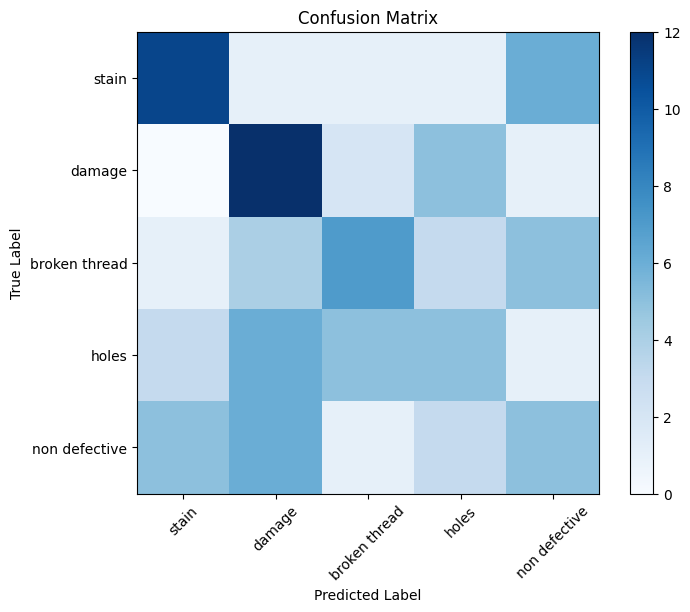

Loading image: /content/FDD Classification Augmantation new/Test/Knitted/Printed/stain/WIN_20241018_11_37_57_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Knitted/Printed/stain/WIN_20241018_11_37_39_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Knitted/Printed/stain/WIN_20241029_17_18_13_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Knitted/Printed/damage/WIN_20241028_21_23_08_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Knitted/Printed/damage/WIN_20241028_19_18_26_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Knitted/Printed/damage/WIN_20241029_17_18_40_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Knitted/Printed/broken thread/WIN_20241028_20_24_09_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Knitted/Printed/broken thread/WIN_20241029_17_17_20_Pro.jpg
Loading image: /content/FDD Classification Au

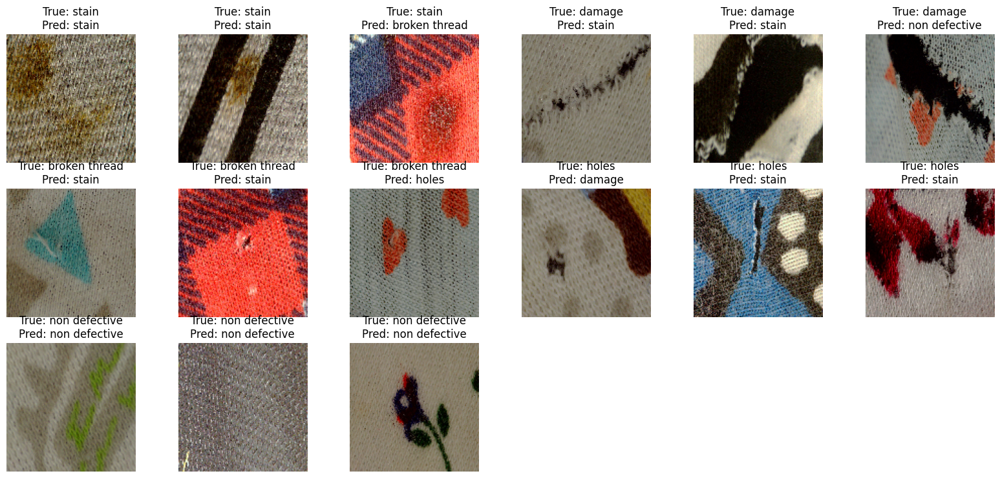

In [ ]:
import cv2
import numpy as np
from keras.models import load_model
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, f1_score
import matplotlib.pyplot as plt
import os

# Load the saved model
model_path = '/content/model_knitted_printed.h5'
model = load_model(model_path)
print("Model loaded successfully.")

# Define categories and initialize lists to track true and predicted labels
categories = ['stain', 'damage', 'broken thread', 'holes', 'non defective']
true_labels = []
predicted_labels = []

# Function to preprocess and predict on a single image
def predict_defect(image_path):
    img = cv2.imread(image_path)
    img = cv2.resize(img, (28, 28))  # Resize to 28x28 pixels
    img = img.astype('float32') / 255.0  # Normalize
    img = img.reshape(1, -1, img.shape[2])  # Reshape for LSTM input

    # Predict the defect class
    prediction = model.predict(img)
    predicted_class = np.argmax(prediction, axis=1)[0]
    return predicted_class

# Load and predict on new test dataset
test_dir = '/content/FDD Classification Augmantation new/Test/Knitted/Printed'
for category_index, category in enumerate(categories):
    category_path = os.path.join(test_dir, category)
    if not os.path.exists(category_path):
        print(f"Directory {category_path} does not exist. Skipping.")
        continue

    for img_file in os.listdir(category_path):
        img_path = os.path.join(category_path, img_file)
        if img_file.endswith('.jpg'):
            pred_label = predict_defect(img_path)
            true_labels.append(category_index)
            predicted_labels.append(pred_label)

# Get unique classes from the true and predicted labels
unique_labels = np.unique(np.concatenate((true_labels, predicted_labels)))

# Classification Report and Metrics
print("\nClassification Report:")
class_report = classification_report(
    true_labels,
    predicted_labels,
    labels=unique_labels,  # Use the unique labels
    target_names=categories,
    output_dict=True,
    zero_division=0
)

print(class_report)


# Confusion Matrix
conf_matrix = confusion_matrix(true_labels, predicted_labels)
print("\nConfusion Matrix:\n", conf_matrix)

# Class-Specific Accuracy
category_accuracies = {}
for i, category in enumerate(categories):
    mask = (np.array(true_labels) == i)
    correct_predictions = (np.array(predicted_labels)[mask] == i).sum()
    category_accuracies[category] = correct_predictions / mask.sum() if mask.sum() > 0 else 0
    print(f"Accuracy for {category}: {category_accuracies[category]:.2f}")

# Calculate overall metrics
accuracy_scores = accuracy_score(true_labels, predicted_labels)
f1_scores = f1_score(true_labels, predicted_labels, average=None)
print("\nOverall Accuracy Score: ", accuracy_scores)
print("F1 Scores: ", f1_scores)
print("Average F1 Score: ", np.mean(f1_scores))

# Plot Confusion Matrix
plt.figure(figsize=(8, 6))
plt.imshow(conf_matrix, interpolation='nearest', cmap=plt.cm.Blues)
plt.title("Confusion Matrix")
plt.colorbar()
plt.xticks(np.arange(len(categories)), categories, rotation=45)
plt.yticks(np.arange(len(categories)), categories)
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

# Display sample images with true and predicted labels (3 images per category)
plt.figure(figsize=(20, 15))
displayed_count = {category: 0 for category in categories}
max_images_per_class = 3
displayed_images = 0

# Loop over the categories to display images
for category_index, category in enumerate(categories):
    category_path = os.path.join(test_dir, category)
    if not os.path.exists(category_path):
        print(f"Directory {category_path} does not exist. Skipping.")
        continue

    for img_file in os.listdir(category_path):
        if displayed_count[category] < max_images_per_class and img_file.endswith('.jpg'):
            img_path = os.path.join(category_path, img_file)
            print(f"Loading image: {img_path}")  # Print the image path for debugging
            img = cv2.imread(img_path)

            # Check if the image was loaded successfully
            if img is not None:
                img = cv2.resize(img, (128, 128))  # Resize for better display quality
                plt.subplot(5, 6, displayed_images + 1)
                plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB
                plt.title(f"True: {category}\nPred: {categories[predicted_labels[displayed_images]]}")
                plt.axis('off')

                displayed_count[category] += 1
                displayed_images += 1

                # Stop after showing 3 images per category
                if displayed_images >= max_images_per_class * len(categories):
                    break
            else:
                print(f"Warning: Image at path '{img_path}' could not be loaded.")  # Print a warning if the image fails to load

plt.show()


Image counts per category: {'stain': 200, 'damage': 200, 'broken thread': 200, 'holes': 200, 'non defective': 200}
Shape of trainX: (800, 784, 3)
Shape of testX: (200, 784, 3)
Shape of trainY: (800, 5)
Shape of testY: (200, 5)


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ lstm_4 (LSTM)                        │ (None, 784, 128)            │          67,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_4 (Dropout)                  │ (None, 784, 128)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv1d_4 (Conv1D)                    │ (None, 784, 64)             │          24,640 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_4                │ (None, 784, 64)             │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling1d_4 (MaxPooling1D)       │ (None, 392, 64)             │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_4 (Flatten)                  │ (None, 25088)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_4 (Dense)                      │ (None, 5)                   │         125,445 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 217,925 (851.27 KB)

 Trainable params: 217,797 (850.77 KB)

 Non-trainable params: 128 (512.00 B)

None
Epoch 1/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 43s 2s/step - accuracy: 0.2575 - loss: 3.8494 - val_accuracy: 0.1900 - val_loss: 2.5640 - learning_rate: 0.0010
Epoch 2/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 42s 2s/step - accuracy: 0.2652 - loss: 2.6772 - val_accuracy: 0.1900 - val_loss: 2.5331 - learning_rate: 0.0010
Epoch 3/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 65s 1s/step - accuracy: 0.2743 - loss: 2.5208 - val_accuracy: 0.2050 - val_loss: 2.4879 - learning_rate: 0.0010
Epoch 4/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 42s 1s/step - accuracy: 0.3335 - loss: 2.3670 - val_accuracy: 0.1900 - val_loss: 2.4467 - learning_rate: 0.0010
Epoch 5/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 41s 1s/step - accuracy: 0.3746 - loss: 2.3076 - val_accuracy: 0.1900 - val_loss: 2.3936 - learning_rate: 0.0010
Epoch 6/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 41s 1s/step - accuracy: 0.3944 - loss: 2.1949 - val_accuracy: 0.1850 - val_loss: 2.3484 - learning_rate: 0.0010
Epoch 7/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 39s 978ms/step - accuracy: 0.4280 - loss: 2.0454 - val_ac

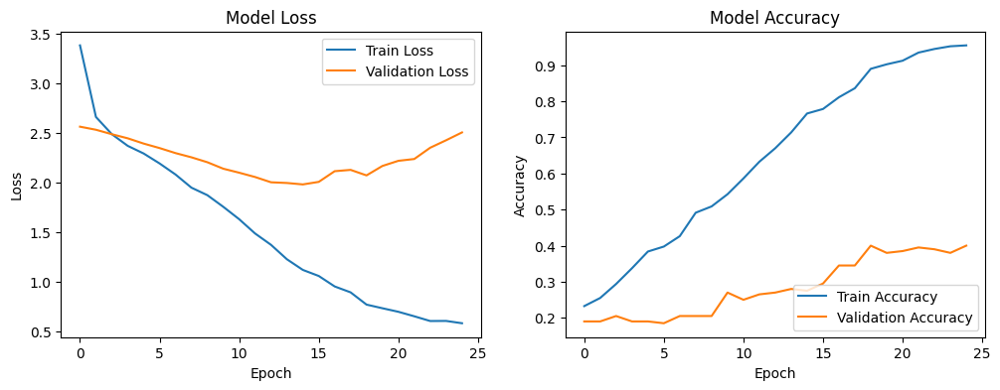

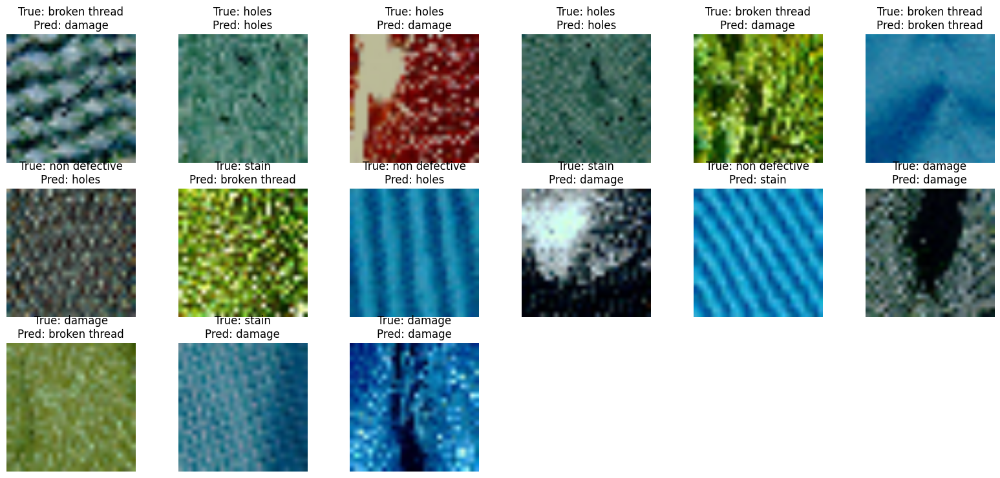

In [ ]:
#LSTM-CNN model
import os
import cv2
import numpy as np
import time
from keras.models import Sequential
from keras.layers import LSTM, Dense, Dropout, Flatten, Conv1D, MaxPooling1D, BatchNormalization
from keras.utils import to_categorical
from keras.callbacks import ReduceLROnPlateau, EarlyStopping
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, f1_score
import matplotlib.pyplot as plt

# Function to load the Kaggle image dataset in .jpg format
def load_dataset():
    base_dir = '/content/FDD Classification Augmantation new/Train/Woven/Dyed'
    categories = ['stain', 'damage', 'broken thread', 'holes', 'non defective']
    images = []
    labels = []
    category_counts = {category: 0 for category in categories}
    # To track the number of images per category

    for label, category in enumerate(categories):
        category_dir = os.path.join(base_dir, category)
        if not os.path.exists(category_dir):
            print(f"Directory {category_dir} does not exist. Skipping this category.")
            continue
        for filename in os.listdir(category_dir):
            if filename.endswith('.jpg'):
                img = cv2.imread(os.path.join(category_dir, filename))
                img = cv2.resize(img, (28, 28))  # Resize image to 28x28
                images.append(img)
                labels.append(label)
                category_counts[category] += 1  # Count the images for each category

    images = np.array(images)
    labels = np.array(labels)

    print("Image counts per category:", category_counts)  # Print the counts for debugging

    return images, labels, categories

# Load the Kaggle image dataset
images, labels, categories = load_dataset()

if len(images) == 0:
    raise ValueError("No images found. Please check the dataset path and ensure images are available.")

# Preprocess the images (normalize pixel values)
images = images.astype('float32') / 255.0

# Convert labels to one-hot encoding
labels = to_categorical(labels, num_classes=len(categories))

# Reshape images for LSTM input (assuming each image is treated as a sequence of pixels)
images = images.reshape(images.shape[0], -1, images.shape[3])  # Adjust to (batch_size, sequence_length, feature_dim)

# Split the dataset into training and test sets
trainX, testX, trainY, testY = train_test_split(images, labels, test_size=0.2, random_state=42)

# Verify shapes of trainX, testX, trainY, testY
print("Shape of trainX:", trainX.shape)
print("Shape of testX:", testX.shape)
print("Shape of trainY:", trainY.shape)
print("Shape of testY:", testY.shape)

# Define the single LSTM-CNN model
model = Sequential()
model.add(LSTM(128, input_shape=(trainX.shape[1], trainX.shape[2]), return_sequences=True))
model.add(Dropout(0.5))


# Ensure the input dimension is compatible with Conv1D
model.add(Conv1D(64, 3, activation='relu', padding='same', kernel_regularizer='l2'))
model.add(BatchNormalization())
model.add(MaxPooling1D(2))

# Flatten and add the output layer
model.add(Flatten())
model.add(Dense(len(categories), activation='softmax', kernel_regularizer='l2'))

# Compile the model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Print model summary
print(model.summary())

# Callbacks for learning rate reduction and early stopping
lr_reduction = ReduceLROnPlateau(monitor='val_loss', patience=3, verbose=1, factor=0.5, min_lr=0.000001)
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# Train the model
start_time = time.time()
history = model.fit(trainX, trainY, epochs=90, batch_size=32, validation_data=(testX, testY), callbacks=[lr_reduction, early_stopping], verbose=1)
end_time = time.time()

# Evaluate the model
loss, accuracy = model.evaluate(testX, testY, verbose=0)
print('Test Loss:', loss)
print('Test Accuracy:', accuracy)

# Get predictions for the test set
predY = model.predict(testX)
predY_classes = np.argmax(predY, axis=1)
trueY_classes = np.argmax(testY, axis=1)

# Ensure we only use labels present in the test set
unique_true_labels = np.unique(trueY_classes)

# Print classification report
class_report = classification_report(
    trueY_classes, predY_classes,
    target_names=[categories[i] for i in unique_true_labels],
    output_dict=True,
    zero_division=0
)
print(class_report)

# Print confusion matrix
conf_matrix = confusion_matrix(trueY_classes, predY_classes)
print(conf_matrix)

# Calculate and print additional metrics
accuracy_scores = accuracy_score(trueY_classes, predY_classes)
f1_scores = f1_score(trueY_classes, predY_classes, average=None)

print("Accuracy Scores: ", accuracy_scores)
print("F1 Scores: ", f1_scores)
print("Average F1 Score: ", np.mean(f1_scores))

# Calculate and display accuracy for each category
category_accuracies = {}
for i, category in enumerate(categories):
    category_mask = (trueY_classes == i)
    category_correct = (predY_classes[category_mask] == i).sum()
    category_total = category_mask.sum()
    category_accuracies[category] = category_correct / category_total
    print(f"Accuracy for {category}: {category_accuracies[category]:.2f}")

print(f"Total Training Time: {end_time - start_time} seconds")

# Plot training & validation loss and accuracy values
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper right')

plt.subplot(1, 2, 2)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')

plt.show()

# Visualize test images with improved pixel quality and ensure class representation
plt.figure(figsize=(20, 15))

# Dictionary to track how many images have been displayed per class
displayed_count = {category: 0 for category in categories}

# Maximum number of images to display per class
max_images_per_class = 3

displayed_images = 0
for i in range(len(testX)):
    true_label = categories[trueY_classes[i]]
    if displayed_count[true_label] < max_images_per_class:
        plt.subplot(5, 6, displayed_images + 1)  # Adjusting the grid for 18 images
        resized_image = cv2.resize(testX[i].reshape(28, 28, 3), (128, 128))  # Rescale for better quality
        plt.imshow(resized_image)
        plt.title(f"True: {true_label}\nPred: {categories[predY_classes[i]]}")
        plt.axis('off')

        displayed_count[true_label] += 1
        displayed_images += 1

    # Break the loop after displaying 18 images (3 images per class, 6 classes)
    if displayed_images >= max_images_per_class * len(categories):
        break

plt.show()


In [ ]:
# Save the trained model in .h5 format for Raspberry Pi
model.save('/content/model_woven_Dyed.h5')
print("Model saved in .h5 format.")


Model saved in .h5 format.


Model loaded successfully.
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 287ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/ste

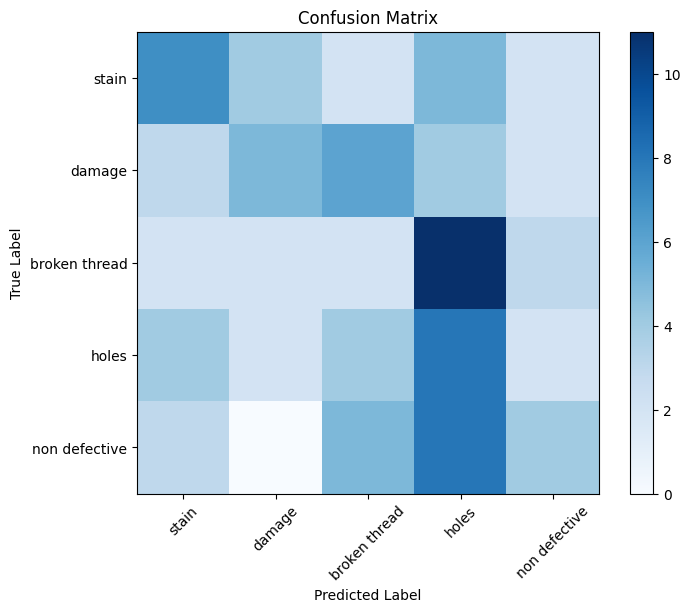

Loading image: /content/FDD Classification Augmantation new/Test/Woven/Dyed/stain/WIN_20240801_19_18_40_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Woven/Dyed/stain/WIN_20240802_21_02_21_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Woven/Dyed/stain/WIN_20241018_12_00_47_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Woven/Dyed/damage/WIN_20241018_12_13_11_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Woven/Dyed/damage/WIN_20241028_19_12_14_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Woven/Dyed/damage/WIN_20240801_18_51_53_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Woven/Dyed/broken thread/WIN_20240801_18_48_11_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Woven/Dyed/broken thread/WIN_20240802_21_13_00_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Woven/Dyed/broken th

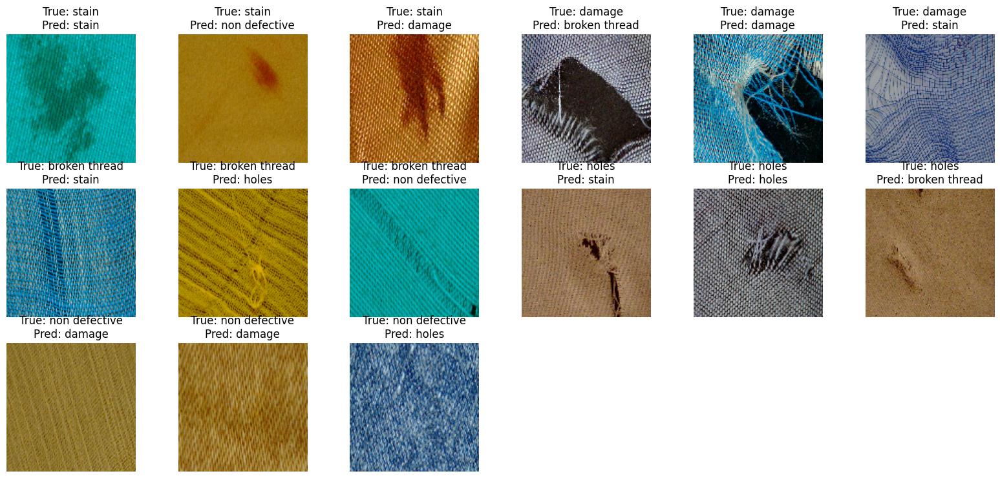

In [ ]:
import cv2
import numpy as np
from keras.models import load_model
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, f1_score
import matplotlib.pyplot as plt
import os

# Load the saved model
model_path = '/content/model_woven_Dyed.h5'
model = load_model(model_path)
print("Model loaded successfully.")

# Define categories and initialize lists to track true and predicted labels
categories = ['stain', 'damage', 'broken thread', 'holes', 'non defective']
true_labels = []
predicted_labels = []

# Function to preprocess and predict on a single image
def predict_defect(image_path):
    img = cv2.imread(image_path)
    img = cv2.resize(img, (28, 28))  # Resize to 28x28 pixels
    img = img.astype('float32') / 255.0  # Normalize
    img = img.reshape(1, -1, img.shape[2])  # Reshape for LSTM input

    # Predict the defect class
    prediction = model.predict(img)
    predicted_class = np.argmax(prediction, axis=1)[0]
    return predicted_class

# Load and predict on new test dataset
test_dir = '/content/FDD Classification Augmantation new/Test/Woven/Dyed'
for category_index, category in enumerate(categories):
    category_path = os.path.join(test_dir, category)
    if not os.path.exists(category_path):
        print(f"Directory {category_path} does not exist. Skipping.")
        continue

    for img_file in os.listdir(category_path):
        img_path = os.path.join(category_path, img_file)
        if img_file.endswith('.jpg'):
            pred_label = predict_defect(img_path)
            true_labels.append(category_index)
            predicted_labels.append(pred_label)

# Get unique classes from the true and predicted labels
unique_labels = np.unique(np.concatenate((true_labels, predicted_labels)))

# Classification Report and Metrics
print("\nClassification Report:")
class_report = classification_report(
    true_labels,
    predicted_labels,
    labels=unique_labels,  # Use the unique labels
    target_names=categories,
    output_dict=True,
    zero_division=0
)

print(class_report)


# Confusion Matrix
conf_matrix = confusion_matrix(true_labels, predicted_labels)
print("\nConfusion Matrix:\n", conf_matrix)

# Class-Specific Accuracy
category_accuracies = {}
for i, category in enumerate(categories):
    mask = (np.array(true_labels) == i)
    correct_predictions = (np.array(predicted_labels)[mask] == i).sum()
    category_accuracies[category] = correct_predictions / mask.sum() if mask.sum() > 0 else 0
    print(f"Accuracy for {category}: {category_accuracies[category]:.2f}")

# Calculate overall metrics
accuracy_scores = accuracy_score(true_labels, predicted_labels)
f1_scores = f1_score(true_labels, predicted_labels, average=None)
print("\nOverall Accuracy Score: ", accuracy_scores)
print("F1 Scores: ", f1_scores)
print("Average F1 Score: ", np.mean(f1_scores))

# Plot Confusion Matrix
plt.figure(figsize=(8, 6))
plt.imshow(conf_matrix, interpolation='nearest', cmap=plt.cm.Blues)
plt.title("Confusion Matrix")
plt.colorbar()
plt.xticks(np.arange(len(categories)), categories, rotation=45)
plt.yticks(np.arange(len(categories)), categories)
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

# Display sample images with true and predicted labels (3 images per category)
plt.figure(figsize=(20, 15))
displayed_count = {category: 0 for category in categories}
max_images_per_class = 3
displayed_images = 0

# Loop over the categories to display images
for category_index, category in enumerate(categories):
    category_path = os.path.join(test_dir, category)
    if not os.path.exists(category_path):
        print(f"Directory {category_path} does not exist. Skipping.")
        continue

    for img_file in os.listdir(category_path):
        if displayed_count[category] < max_images_per_class and img_file.endswith('.jpg'):
            img_path = os.path.join(category_path, img_file)
            print(f"Loading image: {img_path}")  # Print the image path for debugging
            img = cv2.imread(img_path)

            # Check if the image was loaded successfully
            if img is not None:
                img = cv2.resize(img, (128, 128))  # Resize for better display quality
                plt.subplot(5, 6, displayed_images + 1)
                plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB
                plt.title(f"True: {category}\nPred: {categories[predicted_labels[displayed_images]]}")
                plt.axis('off')

                displayed_count[category] += 1
                displayed_images += 1

                # Stop after showing 3 images per category
                if displayed_images >= max_images_per_class * len(categories):
                    break
            else:
                print(f"Warning: Image at path '{img_path}' could not be loaded.")  # Print a warning if the image fails to load

plt.show()


Image counts per category: {'stain': 200, 'damage': 200, 'broken thread': 200, 'holes': 200, 'non defective': 200}
Shape of trainX: (800, 784, 3)
Shape of testX: (200, 784, 3)
Shape of trainY: (800, 5)
Shape of testY: (200, 5)


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_5"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ lstm_5 (LSTM)                        │ (None, 784, 128)            │          67,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_5 (Dropout)                  │ (None, 784, 128)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv1d_5 (Conv1D)                    │ (None, 784, 64)             │          24,640 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_5                │ (None, 784, 64)             │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling1d_5 (MaxPooling1D)       │ (None, 392, 64)             │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_5 (Flatten)                  │ (None, 25088)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_5 (Dense)                      │ (None, 5)                   │         125,445 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 217,925 (851.27 KB)

 Trainable params: 217,797 (850.77 KB)

 Non-trainable params: 128 (512.00 B)

None
Epoch 1/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 52s 2s/step - accuracy: 0.2654 - loss: 3.4807 - val_accuracy: 0.1850 - val_loss: 2.5367 - learning_rate: 0.0010
Epoch 2/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 72s 1s/step - accuracy: 0.3768 - loss: 2.2863 - val_accuracy: 0.1900 - val_loss: 2.4678 - learning_rate: 0.0010
Epoch 3/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 41s 1s/step - accuracy: 0.4428 - loss: 2.1646 - val_accuracy: 0.1900 - val_loss: 2.3987 - learning_rate: 0.0010
Epoch 4/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 33s 1s/step - accuracy: 0.5077 - loss: 1.9718 - val_accuracy: 0.2200 - val_loss: 2.2962 - learning_rate: 0.0010
Epoch 5/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 37s 960ms/step - accuracy: 0.5512 - loss: 1.7937 - val_accuracy: 0.3250 - val_loss: 2.1935 - learning_rate: 0.0010
Epoch 6/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 41s 979ms/step - accuracy: 0.5531 - loss: 1.7324 - val_accuracy: 0.3750 - val_loss: 2.1230 - learning_rate: 0.0010
Epoch 7/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 41s 976ms/step - accuracy: 0.6086 - loss: 1.5995 - 

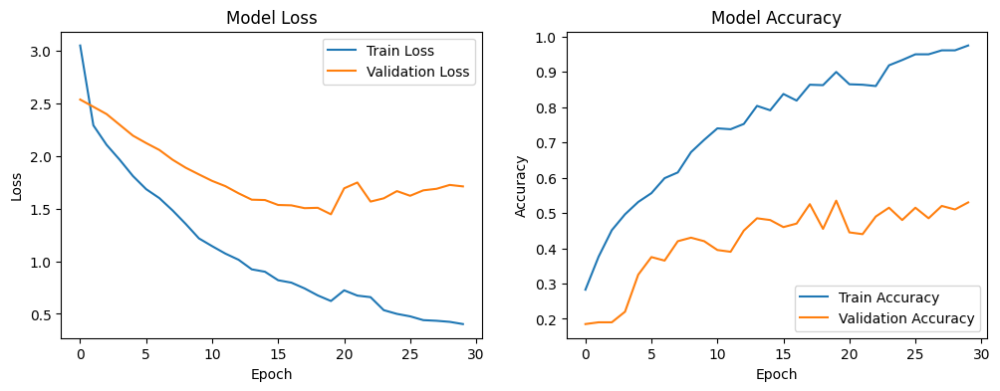

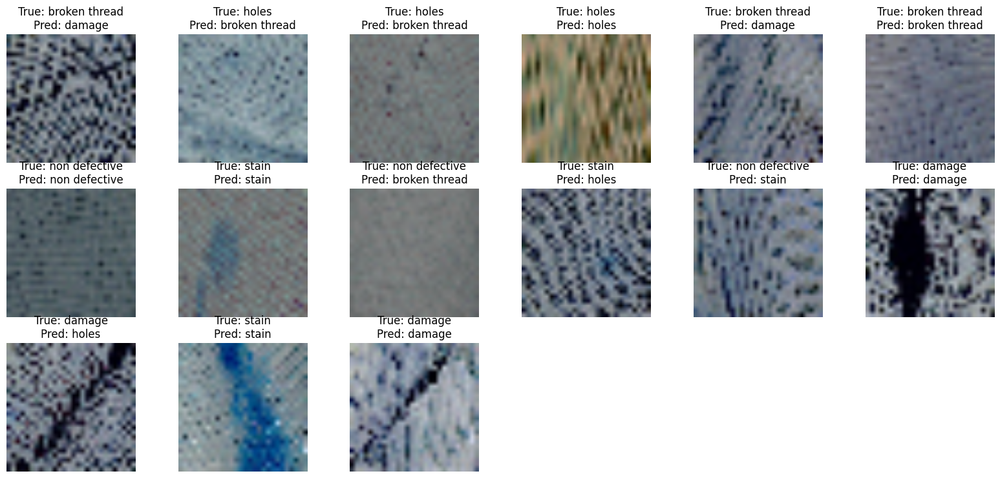

In [ ]:
#LSTM-CNN model
import os
import cv2
import numpy as np
import time
from keras.models import Sequential
from keras.layers import LSTM, Dense, Dropout, Flatten, Conv1D, MaxPooling1D, BatchNormalization
from keras.utils import to_categorical
from keras.callbacks import ReduceLROnPlateau, EarlyStopping
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, f1_score
import matplotlib.pyplot as plt

# Function to load the Kaggle image dataset in .jpg format
def load_dataset():
    base_dir = '/content/FDD Classification Augmantation new/Train/Woven/Gray'
    categories = ['stain', 'damage', 'broken thread', 'holes', 'non defective']
    images = []
    labels = []
    category_counts = {category: 0 for category in categories}
    # To track the number of images per category

    for label, category in enumerate(categories):
        category_dir = os.path.join(base_dir, category)
        if not os.path.exists(category_dir):
            print(f"Directory {category_dir} does not exist. Skipping this category.")
            continue
        for filename in os.listdir(category_dir):
            if filename.endswith('.jpg'):
                img = cv2.imread(os.path.join(category_dir, filename))
                img = cv2.resize(img, (28, 28))  # Resize image to 28x28
                images.append(img)
                labels.append(label)
                category_counts[category] += 1  # Count the images for each category

    images = np.array(images)
    labels = np.array(labels)

    print("Image counts per category:", category_counts)  # Print the counts for debugging

    return images, labels, categories

# Load the Kaggle image dataset
images, labels, categories = load_dataset()

if len(images) == 0:
    raise ValueError("No images found. Please check the dataset path and ensure images are available.")

# Preprocess the images (normalize pixel values)
images = images.astype('float32') / 255.0

# Convert labels to one-hot encoding
labels = to_categorical(labels, num_classes=len(categories))

# Reshape images for LSTM input (assuming each image is treated as a sequence of pixels)
images = images.reshape(images.shape[0], -1, images.shape[3])  # Adjust to (batch_size, sequence_length, feature_dim)

# Split the dataset into training and test sets
trainX, testX, trainY, testY = train_test_split(images, labels, test_size=0.2, random_state=42)

# Verify shapes of trainX, testX, trainY, testY
print("Shape of trainX:", trainX.shape)
print("Shape of testX:", testX.shape)
print("Shape of trainY:", trainY.shape)
print("Shape of testY:", testY.shape)

# Define the single LSTM-CNN model
model = Sequential()
model.add(LSTM(128, input_shape=(trainX.shape[1], trainX.shape[2]), return_sequences=True))
model.add(Dropout(0.5))


# Ensure the input dimension is compatible with Conv1D
model.add(Conv1D(64, 3, activation='relu', padding='same', kernel_regularizer='l2'))
model.add(BatchNormalization())
model.add(MaxPooling1D(2))

# Flatten and add the output layer
model.add(Flatten())
model.add(Dense(len(categories), activation='softmax', kernel_regularizer='l2'))

# Compile the model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Print model summary
print(model.summary())

# Callbacks for learning rate reduction and early stopping
lr_reduction = ReduceLROnPlateau(monitor='val_loss', patience=3, verbose=1, factor=0.5, min_lr=0.000001)
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# Train the model
start_time = time.time()
history = model.fit(trainX, trainY, epochs=90, batch_size=32, validation_data=(testX, testY), callbacks=[lr_reduction, early_stopping], verbose=1)
end_time = time.time()

# Evaluate the model
loss, accuracy = model.evaluate(testX, testY, verbose=0)
print('Test Loss:', loss)
print('Test Accuracy:', accuracy)

# Get predictions for the test set
predY = model.predict(testX)
predY_classes = np.argmax(predY, axis=1)
trueY_classes = np.argmax(testY, axis=1)

# Ensure we only use labels present in the test set
unique_true_labels = np.unique(trueY_classes)

# Print classification report
class_report = classification_report(
    trueY_classes, predY_classes,
    target_names=[categories[i] for i in unique_true_labels],
    output_dict=True,
    zero_division=0
)
print(class_report)

# Print confusion matrix
conf_matrix = confusion_matrix(trueY_classes, predY_classes)
print(conf_matrix)

# Calculate and print additional metrics
accuracy_scores = accuracy_score(trueY_classes, predY_classes)
f1_scores = f1_score(trueY_classes, predY_classes, average=None)

print("Accuracy Scores: ", accuracy_scores)
print("F1 Scores: ", f1_scores)
print("Average F1 Score: ", np.mean(f1_scores))

# Calculate and display accuracy for each category
category_accuracies = {}
for i, category in enumerate(categories):
    category_mask = (trueY_classes == i)
    category_correct = (predY_classes[category_mask] == i).sum()
    category_total = category_mask.sum()
    category_accuracies[category] = category_correct / category_total
    print(f"Accuracy for {category}: {category_accuracies[category]:.2f}")

print(f"Total Training Time: {end_time - start_time} seconds")

# Plot training & validation loss and accuracy values
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper right')

plt.subplot(1, 2, 2)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')

plt.show()

# Visualize test images with improved pixel quality and ensure class representation
plt.figure(figsize=(20, 15))

# Dictionary to track how many images have been displayed per class
displayed_count = {category: 0 for category in categories}

# Maximum number of images to display per class
max_images_per_class = 3

displayed_images = 0
for i in range(len(testX)):
    true_label = categories[trueY_classes[i]]
    if displayed_count[true_label] < max_images_per_class:
        plt.subplot(5, 6, displayed_images + 1)  # Adjusting the grid for 18 images
        resized_image = cv2.resize(testX[i].reshape(28, 28, 3), (128, 128))  # Rescale for better quality
        plt.imshow(resized_image)
        plt.title(f"True: {true_label}\nPred: {categories[predY_classes[i]]}")
        plt.axis('off')

        displayed_count[true_label] += 1
        displayed_images += 1

    # Break the loop after displaying 18 images (3 images per class, 6 classes)
    if displayed_images >= max_images_per_class * len(categories):
        break

plt.show()


In [ ]:
# Save the trained model in .h5 format for Raspberry Pi
model.save('/content/model_woven_Gray.h5')
print("Model saved in .h5 format.")


Model saved in .h5 format.


Model loaded successfully.
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 201ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 292ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 194ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 187ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/ste

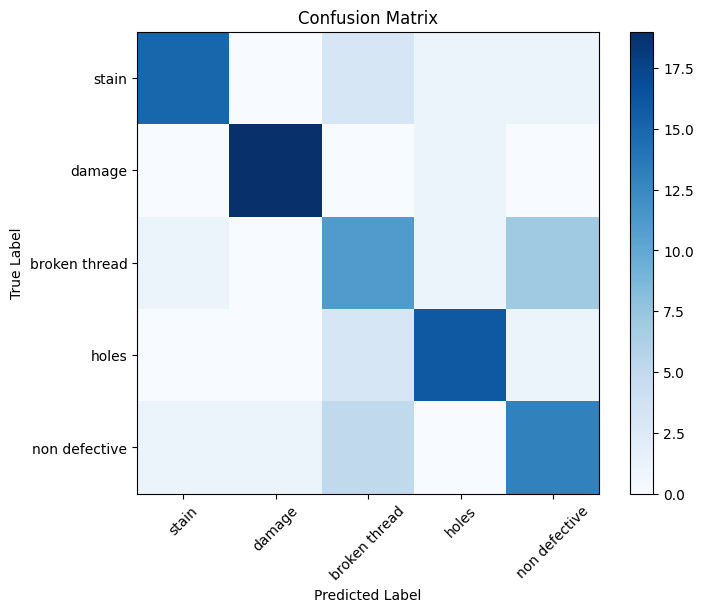

Loading image: /content/FDD Classification Augmantation new/Test/Woven/Gray/stain/WIN_20241029_13_50_03_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Woven/Gray/stain/WIN_20241028_22_04_00_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Woven/Gray/stain/WIN_20241029_13_33_53_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Woven/Gray/damage/WIN_20241028_19_45_01_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Woven/Gray/damage/WIN_20241028_19_38_39_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Woven/Gray/damage/WIN_20241029_13_52_09_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Woven/Gray/broken thread/WIN_20241029_13_31_32_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Woven/Gray/broken thread/WIN_20241028_21_59_53_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Woven/Gray/broken th

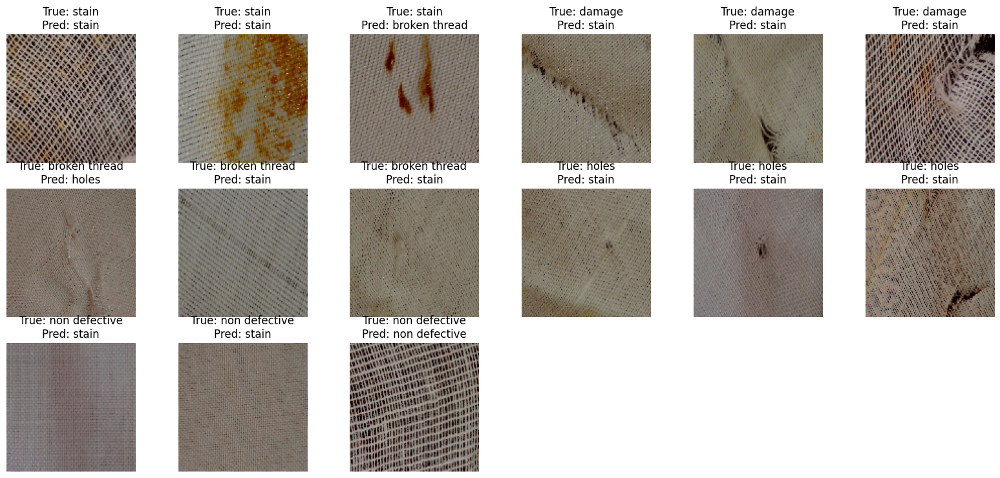

In [ ]:
import cv2
import numpy as np
from keras.models import load_model
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, f1_score
import matplotlib.pyplot as plt
import os

# Load the saved model
model_path = '/content/model_woven_Gray.h5'
model = load_model(model_path)
print("Model loaded successfully.")

# Define categories and initialize lists to track true and predicted labels
categories = ['stain', 'damage', 'broken thread', 'holes', 'non defective']
true_labels = []
predicted_labels = []

# Function to preprocess and predict on a single image
def predict_defect(image_path):
    img = cv2.imread(image_path)
    img = cv2.resize(img, (28, 28))  # Resize to 28x28 pixels
    img = img.astype('float32') / 255.0  # Normalize
    img = img.reshape(1, -1, img.shape[2])  # Reshape for LSTM input

    # Predict the defect class
    prediction = model.predict(img)
    predicted_class = np.argmax(prediction, axis=1)[0]
    return predicted_class

# Load and predict on new test dataset
test_dir = '/content/FDD Classification Augmantation new/Test/Woven/Gray'
for category_index, category in enumerate(categories):
    category_path = os.path.join(test_dir, category)
    if not os.path.exists(category_path):
        print(f"Directory {category_path} does not exist. Skipping.")
        continue

    for img_file in os.listdir(category_path):
        img_path = os.path.join(category_path, img_file)
        if img_file.endswith('.jpg'):
            pred_label = predict_defect(img_path)
            true_labels.append(category_index)
            predicted_labels.append(pred_label)

# Get unique classes from the true and predicted labels
unique_labels = np.unique(np.concatenate((true_labels, predicted_labels)))

# Classification Report and Metrics
print("\nClassification Report:")
class_report = classification_report(
    true_labels,
    predicted_labels,
    labels=unique_labels,  # Use the unique labels
    target_names=categories,
    output_dict=True,
    zero_division=0
)

print(class_report)


# Confusion Matrix
conf_matrix = confusion_matrix(true_labels, predicted_labels)
print("\nConfusion Matrix:\n", conf_matrix)

# Class-Specific Accuracy
category_accuracies = {}
for i, category in enumerate(categories):
    mask = (np.array(true_labels) == i)
    correct_predictions = (np.array(predicted_labels)[mask] == i).sum()
    category_accuracies[category] = correct_predictions / mask.sum() if mask.sum() > 0 else 0
    print(f"Accuracy for {category}: {category_accuracies[category]:.2f}")

# Calculate overall metrics
accuracy_scores = accuracy_score(true_labels, predicted_labels)
f1_scores = f1_score(true_labels, predicted_labels, average=None)
print("\nOverall Accuracy Score: ", accuracy_scores)
print("F1 Scores: ", f1_scores)
print("Average F1 Score: ", np.mean(f1_scores))

# Plot Confusion Matrix
plt.figure(figsize=(8, 6))
plt.imshow(conf_matrix, interpolation='nearest', cmap=plt.cm.Blues)
plt.title("Confusion Matrix")
plt.colorbar()
plt.xticks(np.arange(len(categories)), categories, rotation=45)
plt.yticks(np.arange(len(categories)), categories)
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

# Display sample images with true and predicted labels (3 images per category)
plt.figure(figsize=(20, 15))
displayed_count = {category: 0 for category in categories}
max_images_per_class = 3
displayed_images = 0

# Loop over the categories to display images
for category_index, category in enumerate(categories):
    category_path = os.path.join(test_dir, category)
    if not os.path.exists(category_path):
        print(f"Directory {category_path} does not exist. Skipping.")
        continue

    for img_file in os.listdir(category_path):
        if displayed_count[category] < max_images_per_class and img_file.endswith('.jpg'):
            img_path = os.path.join(category_path, img_file)
            print(f"Loading image: {img_path}")  # Print the image path for debugging
            img = cv2.imread(img_path)

            # Check if the image was loaded successfully
            if img is not None:
                img = cv2.resize(img, (128, 128))  # Resize for better display quality
                plt.subplot(5, 6, displayed_images + 1)
                plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB
                plt.title(f"True: {category}\nPred: {categories[predicted_labels[displayed_images]]}")
                plt.axis('off')

                displayed_count[category] += 1
                displayed_images += 1

                # Stop after showing 3 images per category
                if displayed_images >= max_images_per_class * len(categories):
                    break
            else:
                print(f"Warning: Image at path '{img_path}' could not be loaded.")  # Print a warning if the image fails to load

plt.show()


Image counts per category: {'stain': 200, 'damage': 200, 'broken thread': 200, 'holes': 200, 'non defective': 200}
Shape of trainX: (800, 784, 3)
Shape of testX: (200, 784, 3)
Shape of trainY: (800, 5)
Shape of testY: (200, 5)


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_6"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ lstm_6 (LSTM)                        │ (None, 784, 128)            │          67,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_6 (Dropout)                  │ (None, 784, 128)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv1d_6 (Conv1D)                    │ (None, 784, 64)             │          24,640 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_6                │ (None, 784, 64)             │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling1d_6 (MaxPooling1D)       │ (None, 392, 64)             │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_6 (Flatten)                  │ (None, 25088)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_6 (Dense)                      │ (None, 5)                   │         125,445 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 217,925 (851.27 KB)

 Trainable params: 217,797 (850.77 KB)

 Non-trainable params: 128 (512.00 B)

None
Epoch 1/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 28s 1s/step - accuracy: 0.2189 - loss: 3.3484 - val_accuracy: 0.1650 - val_loss: 2.5511 - learning_rate: 0.0010
Epoch 2/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 39s 960ms/step - accuracy: 0.2718 - loss: 2.5985 - val_accuracy: 0.1950 - val_loss: 2.5149 - learning_rate: 0.0010
Epoch 3/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 41s 966ms/step - accuracy: 0.3532 - loss: 2.4272 - val_accuracy: 0.1850 - val_loss: 2.4740 - learning_rate: 0.0010
Epoch 4/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 41s 968ms/step - accuracy: 0.4018 - loss: 2.2928 - val_accuracy: 0.1900 - val_loss: 2.4103 - learning_rate: 0.0010
Epoch 5/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 41s 964ms/step - accuracy: 0.3228 - loss: 2.2647 - val_accuracy: 0.1950 - val_loss: 2.3725 - learning_rate: 0.0010
Epoch 6/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 41s 959ms/step - accuracy: 0.4794 - loss: 2.0870 - val_accuracy: 0.2350 - val_loss: 2.3103 - learning_rate: 0.0010
Epoch 7/90
25/25 ━━━━━━━━━━━━━━━━━━━━ 42s 987ms/step - accuracy: 0.4898 - loss: 

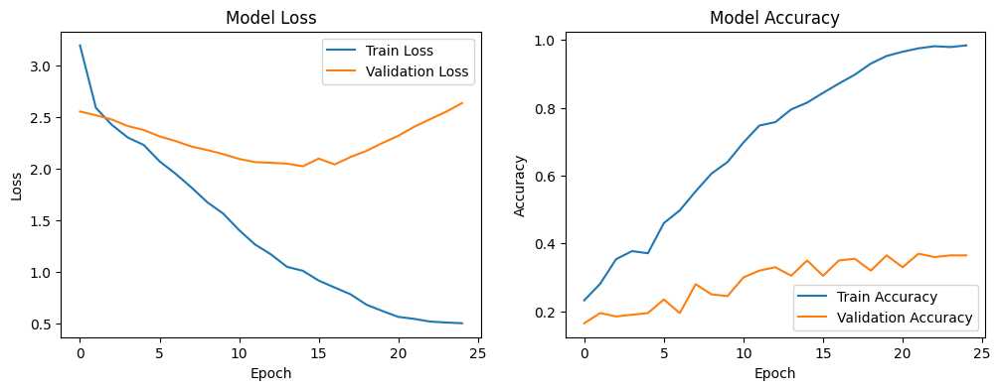

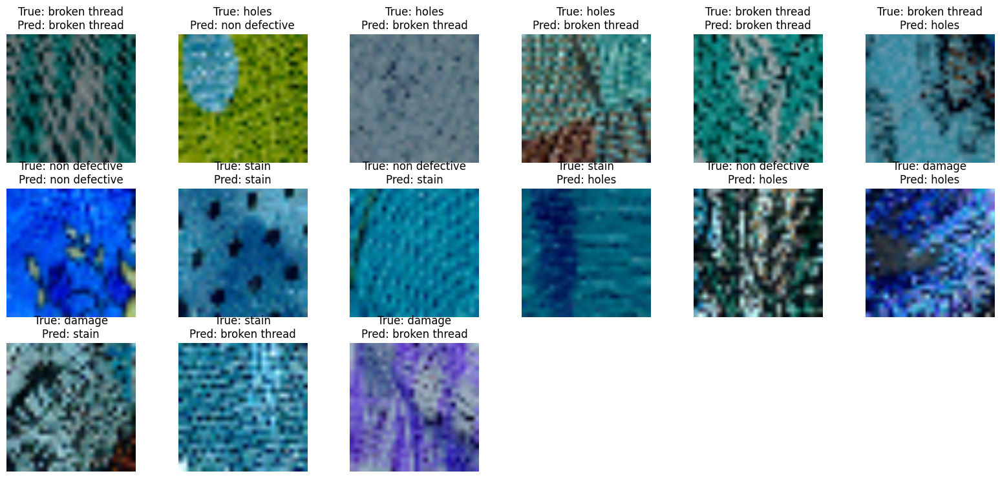

In [ ]:
#LSTM-CNN model
import os
import cv2
import numpy as np
import time
from keras.models import Sequential
from keras.layers import LSTM, Dense, Dropout, Flatten, Conv1D, MaxPooling1D, BatchNormalization
from keras.utils import to_categorical
from keras.callbacks import ReduceLROnPlateau, EarlyStopping
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, f1_score
import matplotlib.pyplot as plt

# Function to load the Kaggle image dataset in .jpg format
def load_dataset():
    base_dir = '/content/FDD Classification Augmantation new/Train/Woven/Printed'
    categories = ['stain', 'damage', 'broken thread', 'holes', 'non defective']
    images = []
    labels = []
    category_counts = {category: 0 for category in categories}
    # To track the number of images per category

    for label, category in enumerate(categories):
        category_dir = os.path.join(base_dir, category)
        if not os.path.exists(category_dir):
            print(f"Directory {category_dir} does not exist. Skipping this category.")
            continue
        for filename in os.listdir(category_dir):
            if filename.endswith('.jpg'):
                img = cv2.imread(os.path.join(category_dir, filename))
                img = cv2.resize(img, (28, 28))  # Resize image to 28x28
                images.append(img)
                labels.append(label)
                category_counts[category] += 1  # Count the images for each category

    images = np.array(images)
    labels = np.array(labels)

    print("Image counts per category:", category_counts)  # Print the counts for debugging

    return images, labels, categories

# Load the Kaggle image dataset
images, labels, categories = load_dataset()

if len(images) == 0:
    raise ValueError("No images found. Please check the dataset path and ensure images are available.")

# Preprocess the images (normalize pixel values)
images = images.astype('float32') / 255.0

# Convert labels to one-hot encoding
labels = to_categorical(labels, num_classes=len(categories))

# Reshape images for LSTM input (assuming each image is treated as a sequence of pixels)
images = images.reshape(images.shape[0], -1, images.shape[3])  # Adjust to (batch_size, sequence_length, feature_dim)

# Split the dataset into training and test sets
trainX, testX, trainY, testY = train_test_split(images, labels, test_size=0.2, random_state=42)

# Verify shapes of trainX, testX, trainY, testY
print("Shape of trainX:", trainX.shape)
print("Shape of testX:", testX.shape)
print("Shape of trainY:", trainY.shape)
print("Shape of testY:", testY.shape)

# Define the single LSTM-CNN model
model = Sequential()
model.add(LSTM(128, input_shape=(trainX.shape[1], trainX.shape[2]), return_sequences=True))
model.add(Dropout(0.5))


# Ensure the input dimension is compatible with Conv1D
model.add(Conv1D(64, 3, activation='relu', padding='same', kernel_regularizer='l2'))
model.add(BatchNormalization())
model.add(MaxPooling1D(2))

# Flatten and add the output layer
model.add(Flatten())
model.add(Dense(len(categories), activation='softmax', kernel_regularizer='l2'))

# Compile the model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Print model summary
print(model.summary())

# Callbacks for learning rate reduction and early stopping
lr_reduction = ReduceLROnPlateau(monitor='val_loss', patience=3, verbose=1, factor=0.5, min_lr=0.000001)
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# Train the model
start_time = time.time()
history = model.fit(trainX, trainY, epochs=90, batch_size=32, validation_data=(testX, testY), callbacks=[lr_reduction, early_stopping], verbose=1)
end_time = time.time()

# Evaluate the model
loss, accuracy = model.evaluate(testX, testY, verbose=0)
print('Test Loss:', loss)
print('Test Accuracy:', accuracy)

# Get predictions for the test set
predY = model.predict(testX)
predY_classes = np.argmax(predY, axis=1)
trueY_classes = np.argmax(testY, axis=1)

# Ensure we only use labels present in the test set
unique_true_labels = np.unique(trueY_classes)

# Print classification report
class_report = classification_report(
    trueY_classes, predY_classes,
    target_names=[categories[i] for i in unique_true_labels],
    output_dict=True,
    zero_division=0
)
print(class_report)

# Print confusion matrix
conf_matrix = confusion_matrix(trueY_classes, predY_classes)
print(conf_matrix)

# Calculate and print additional metrics
accuracy_scores = accuracy_score(trueY_classes, predY_classes)
f1_scores = f1_score(trueY_classes, predY_classes, average=None)

print("Accuracy Scores: ", accuracy_scores)
print("F1 Scores: ", f1_scores)
print("Average F1 Score: ", np.mean(f1_scores))

# Calculate and display accuracy for each category
category_accuracies = {}
for i, category in enumerate(categories):
    category_mask = (trueY_classes == i)
    category_correct = (predY_classes[category_mask] == i).sum()
    category_total = category_mask.sum()
    category_accuracies[category] = category_correct / category_total
    print(f"Accuracy for {category}: {category_accuracies[category]:.2f}")

print(f"Total Training Time: {end_time - start_time} seconds")

# Plot training & validation loss and accuracy values
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(loc='upper right')

plt.subplot(1, 2, 2)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')

plt.show()

# Visualize test images with improved pixel quality and ensure class representation
plt.figure(figsize=(20, 15))

# Dictionary to track how many images have been displayed per class
displayed_count = {category: 0 for category in categories}

# Maximum number of images to display per class
max_images_per_class = 3

displayed_images = 0
for i in range(len(testX)):
    true_label = categories[trueY_classes[i]]
    if displayed_count[true_label] < max_images_per_class:
        plt.subplot(5, 6, displayed_images + 1)  # Adjusting the grid for 18 images
        resized_image = cv2.resize(testX[i].reshape(28, 28, 3), (128, 128))  # Rescale for better quality
        plt.imshow(resized_image)
        plt.title(f"True: {true_label}\nPred: {categories[predY_classes[i]]}")
        plt.axis('off')

        displayed_count[true_label] += 1
        displayed_images += 1

    # Break the loop after displaying 18 images (3 images per class, 6 classes)
    if displayed_images >= max_images_per_class * len(categories):
        break

plt.show()


In [ ]:
# Save the trained model in .h5 format for Raspberry Pi
model.save('/content/model_woven_Printed.h5')
print("Model saved in .h5 format.")


Model saved in .h5 format.


Model loaded successfully.
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/ste

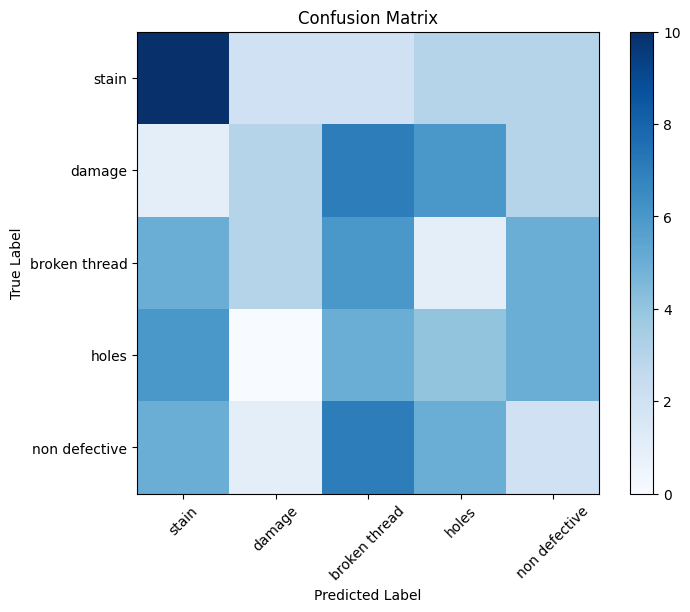

Loading image: /content/FDD Classification Augmantation new/Test/Woven/Printed/stain/WIN_20241018_11_50_48_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Woven/Printed/stain/WIN_20241018_14_26_39_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Woven/Printed/stain/WIN_20241018_14_12_16_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Woven/Printed/damage/WIN_20241028_21_58_31_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Woven/Printed/damage/WIN_20241029_13_20_53_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Woven/Printed/damage/WIN_20241029_15_38_34_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Woven/Printed/broken thread/WIN_20241018_12_34_13_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Woven/Printed/broken thread/WIN_20241028_21_32_10_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/T

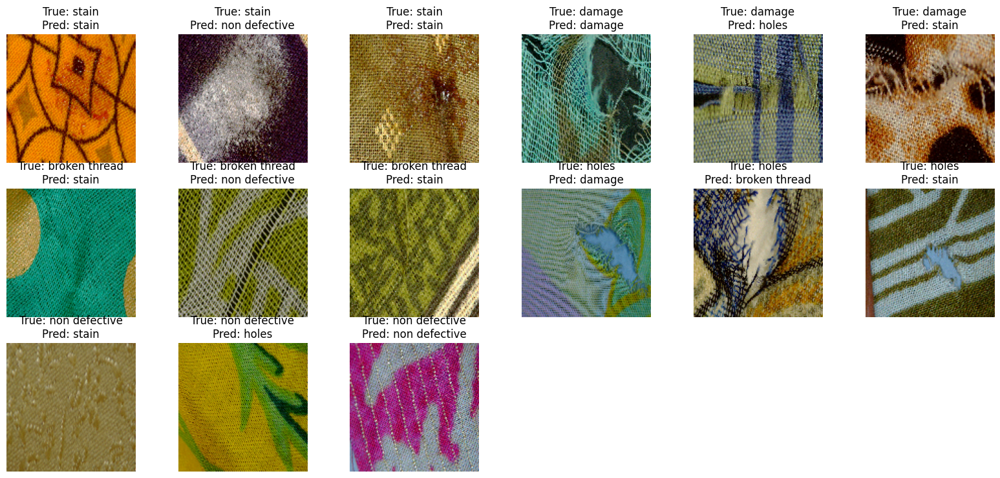

In [ ]:
import cv2
import numpy as np
from keras.models import load_model
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, f1_score
import matplotlib.pyplot as plt
import os

# Load the saved model
model_path = '/content/model_woven_Printed.h5'
model = load_model(model_path)
print("Model loaded successfully.")

# Define categories and initialize lists to track true and predicted labels
categories = ['stain', 'damage', 'broken thread', 'holes', 'non defective']
true_labels = []
predicted_labels = []

# Function to preprocess and predict on a single image
def predict_defect(image_path):
    img = cv2.imread(image_path)
    img = cv2.resize(img, (28, 28))  # Resize to 28x28 pixels
    img = img.astype('float32') / 255.0  # Normalize
    img = img.reshape(1, -1, img.shape[2])  # Reshape for LSTM input

    # Predict the defect class
    prediction = model.predict(img)
    predicted_class = np.argmax(prediction, axis=1)[0]
    return predicted_class

# Load and predict on new test dataset
test_dir = '/content/FDD Classification Augmantation new/Test/Woven/Printed'
for category_index, category in enumerate(categories):
    category_path = os.path.join(test_dir, category)
    if not os.path.exists(category_path):
        print(f"Directory {category_path} does not exist. Skipping.")
        continue

    for img_file in os.listdir(category_path):
        img_path = os.path.join(category_path, img_file)
        if img_file.endswith('.jpg'):
            pred_label = predict_defect(img_path)
            true_labels.append(category_index)
            predicted_labels.append(pred_label)

# Get unique classes from the true and predicted labels
unique_labels = np.unique(np.concatenate((true_labels, predicted_labels)))

# Classification Report and Metrics
print("\nClassification Report:")
class_report = classification_report(
    true_labels,
    predicted_labels,
    labels=unique_labels,  # Use the unique labels
    target_names=categories,
    output_dict=True,
    zero_division=0
)

print(class_report)


# Confusion Matrix
conf_matrix = confusion_matrix(true_labels, predicted_labels)
print("\nConfusion Matrix:\n", conf_matrix)

# Class-Specific Accuracy
category_accuracies = {}
for i, category in enumerate(categories):
    mask = (np.array(true_labels) == i)
    correct_predictions = (np.array(predicted_labels)[mask] == i).sum()
    category_accuracies[category] = correct_predictions / mask.sum() if mask.sum() > 0 else 0
    print(f"Accuracy for {category}: {category_accuracies[category]:.2f}")

# Calculate overall metrics
accuracy_scores = accuracy_score(true_labels, predicted_labels)
f1_scores = f1_score(true_labels, predicted_labels, average=None)
print("\nOverall Accuracy Score: ", accuracy_scores)
print("F1 Scores: ", f1_scores)
print("Average F1 Score: ", np.mean(f1_scores))

# Plot Confusion Matrix
plt.figure(figsize=(8, 6))
plt.imshow(conf_matrix, interpolation='nearest', cmap=plt.cm.Blues)
plt.title("Confusion Matrix")
plt.colorbar()
plt.xticks(np.arange(len(categories)), categories, rotation=45)
plt.yticks(np.arange(len(categories)), categories)
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

# Display sample images with true and predicted labels (3 images per category)
plt.figure(figsize=(20, 15))
displayed_count = {category: 0 for category in categories}
max_images_per_class = 3
displayed_images = 0

# Loop over the categories to display images
for category_index, category in enumerate(categories):
    category_path = os.path.join(test_dir, category)
    if not os.path.exists(category_path):
        print(f"Directory {category_path} does not exist. Skipping.")
        continue

    for img_file in os.listdir(category_path):
        if displayed_count[category] < max_images_per_class and img_file.endswith('.jpg'):
            img_path = os.path.join(category_path, img_file)
            print(f"Loading image: {img_path}")  # Print the image path for debugging
            img = cv2.imread(img_path)

            # Check if the image was loaded successfully
            if img is not None:
                img = cv2.resize(img, (128, 128))  # Resize for better display quality
                plt.subplot(5, 6, displayed_images + 1)
                plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB
                plt.title(f"True: {category}\nPred: {categories[predicted_labels[displayed_images]]}")
                plt.axis('off')

                displayed_count[category] += 1
                displayed_images += 1

                # Stop after showing 3 images per category
                if displayed_images >= max_images_per_class * len(categories):
                    break
            else:
                print(f"Warning: Image at path '{img_path}' could not be loaded.")  # Print a warning if the image fails to load

plt.show()


Select the fabric defect type you want to detect:
1. knitted_Gray
2. knitted_printed
3. knitted_Dyed
4. woven_Gray
5. woven_Printed
6. woven_Dyed
Enter the number corresponding to your choice: 5


Model for 'woven_Printed' loaded successfully.
Enter the path to the test dataset: /content/FDD Classification Augmantation new/Test/Woven/Printed
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 290ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 210ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 193ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 188ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/

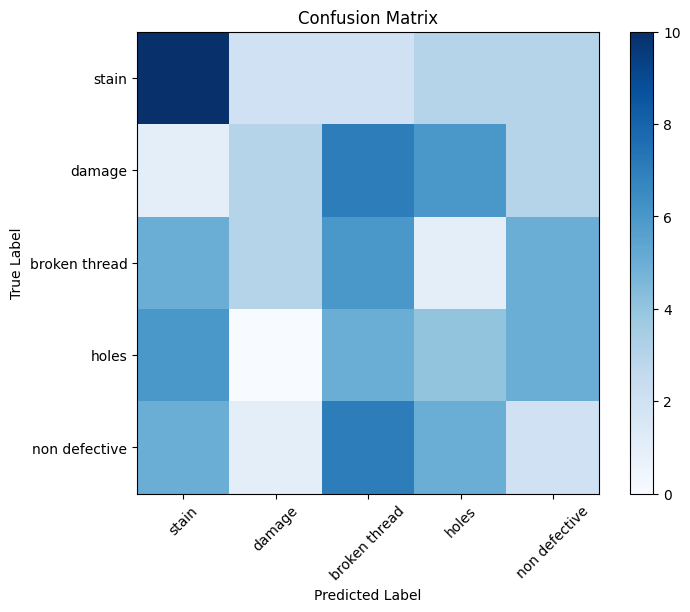

Loading image: /content/FDD Classification Augmantation new/Test/Woven/Printed/stain/WIN_20241018_11_50_48_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Woven/Printed/stain/WIN_20241018_14_26_39_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Woven/Printed/stain/WIN_20241018_14_12_16_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Woven/Printed/damage/WIN_20241028_21_58_31_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Woven/Printed/damage/WIN_20241029_13_20_53_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Woven/Printed/damage/WIN_20241029_15_38_34_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Woven/Printed/broken thread/WIN_20241018_12_34_13_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/Test/Woven/Printed/broken thread/WIN_20241028_21_32_10_Pro.jpg
Loading image: /content/FDD Classification Augmantation new/T

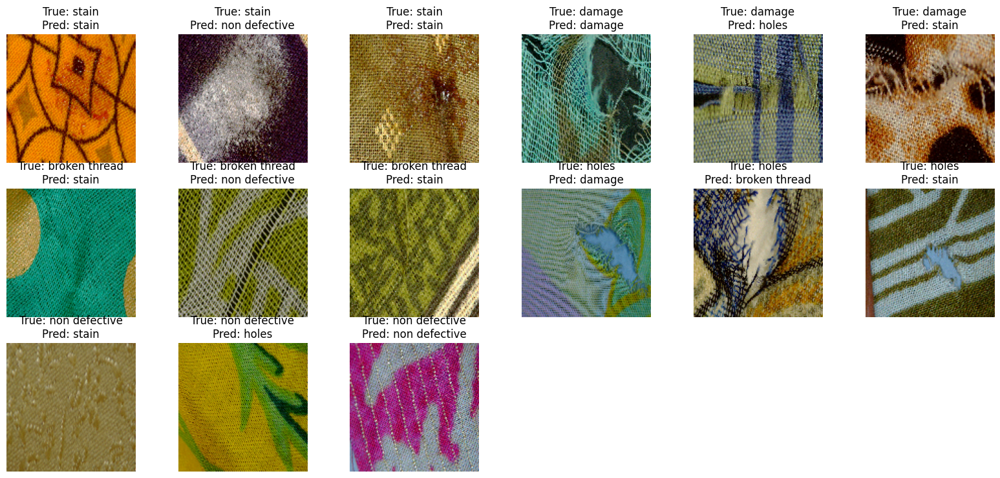

In [ ]:
import cv2
import numpy as np
from keras.models import load_model
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, f1_score
import matplotlib.pyplot as plt
import os

# Define models and their associated fabric types
fabric_models = {
    "1": ("model_knitted_Gray.h5", "knitted_Gray"),
    "2": ("model_knitted_printed.h5", "knitted_printed"),
    "3": ("model_defect_detection.h5", "knitted_Dyed"),
    "4": ("model_woven_Gray.h5", "woven_Gray"),
    "5": ("model_woven_Printed.h5", "woven_Printed"),
    "6": ("model_woven_Dyed.h5", "woven_Dyed")
}

# Display options to the user
print("Select the fabric defect type you want to detect:")
for key, (model_name, fabric_type) in fabric_models.items():
    print(f"{key}. {fabric_type}")

# Get user input for fabric type selection
choice = input("Enter the number corresponding to your choice: ")

# Check if the choice is valid
if choice not in fabric_models:
    print("Invalid choice. Exiting.")
else:
    # Load the selected model and fabric type
    model_path, selected_fabric_type = fabric_models[choice]
    model = load_model(model_path)
    print(f"Model for '{selected_fabric_type}' loaded successfully.")

    # Prompt user to input the path to the test dataset
    test_dir = input("Enter the path to the test dataset: ")

    # Define categories and initialize lists to track true and predicted labels
    categories = ['stain', 'damage', 'broken thread', 'holes', 'non defective']
    true_labels = []
    predicted_labels = []

    # Function to preprocess and predict on a single image
    def predict_defect(image_path):
        img = cv2.imread(image_path)
        img = cv2.resize(img, (28, 28))  # Resize to 28x28 pixels
        img = img.astype('float32') / 255.0  # Normalize
        img = img.reshape(1, -1, img.shape[2])  # Reshape for LSTM input

        # Predict the defect class
        prediction = model.predict(img)
        predicted_class = np.argmax(prediction, axis=1)[0]
        return predicted_class

    # Load and predict on new test dataset
    for category_index, category in enumerate(categories):
        category_path = os.path.join(test_dir, category)
        if not os.path.exists(category_path):
            print(f"Directory {category_path} does not exist. Skipping.")
            continue

        for img_file in os.listdir(category_path):
            img_path = os.path.join(category_path, img_file)
            if img_file.endswith('.jpg'):
                pred_label = predict_defect(img_path)
                true_labels.append(category_index)
                predicted_labels.append(pred_label)

    # Get unique classes from the true and predicted labels
    unique_labels = np.unique(np.concatenate((true_labels, predicted_labels)))

    # Classification Report and Metrics
    print("\nClassification Report:")
    class_report = classification_report(
        true_labels,
        predicted_labels,
        labels=unique_labels,  # Use the unique labels
        target_names=categories,
        output_dict=True,
        zero_division=0
    )
    print(class_report)

    # Confusion Matrix
    conf_matrix = confusion_matrix(true_labels, predicted_labels)
    print("\nConfusion Matrix:\n", conf_matrix)

    # Class-Specific Accuracy
    category_accuracies = {}
    for i, category in enumerate(categories):
        mask = (np.array(true_labels) == i)
        correct_predictions = (np.array(predicted_labels)[mask] == i).sum()
        category_accuracies[category] = correct_predictions / mask.sum() if mask.sum() > 0 else 0
        print(f"Accuracy for {category}: {category_accuracies[category]:.2f}")

    # Calculate overall metrics
    accuracy_scores = accuracy_score(true_labels, predicted_labels)
    f1_scores = f1_score(true_labels, predicted_labels, average=None)
    print("\nOverall Accuracy Score: ", accuracy_scores)
    print("F1 Scores: ", f1_scores)
    print("Average F1 Score: ", np.mean(f1_scores))

    # Plot Confusion Matrix
    plt.figure(figsize=(8, 6))
    plt.imshow(conf_matrix, interpolation='nearest', cmap=plt.cm.Blues)
    plt.title("Confusion Matrix")
    plt.colorbar()
    plt.xticks(np.arange(len(categories)), categories, rotation=45)
    plt.yticks(np.arange(len(categories)), categories)
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.show()
# Display sample images with true and predicted labels (3 images per category)
plt.figure(figsize=(20, 15))
displayed_count = {category: 0 for category in categories}
max_images_per_class = 3
displayed_images = 0

# Loop over the categories to display images
for category_index, category in enumerate(categories):
    category_path = os.path.join(test_dir, category)
    if not os.path.exists(category_path):
        print(f"Directory {category_path} does not exist. Skipping.")
        continue

    for img_file in os.listdir(category_path):
        if displayed_count[category] < max_images_per_class and img_file.endswith('.jpg'):
            img_path = os.path.join(category_path, img_file)
            print(f"Loading image: {img_path}")  # Print the image path for debugging
            img = cv2.imread(img_path)

            # Check if the image was loaded successfully
            if img is not None:
                img = cv2.resize(img, (128, 128))  # Resize for better display quality
                plt.subplot(5, 6, displayed_images + 1)
                plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB
                plt.title(f"True: {category}\nPred: {categories[predicted_labels[displayed_images]]}")
                plt.axis('off')

                displayed_count[category] += 1
                displayed_images += 1

                # Stop after showing 3 images per category
                if displayed_images >= max_images_per_class * len(categories):
                    break
            else:
                print(f"Warning: Image at path '{img_path}' could not be loaded.")  # Print a warning if the image fails to load

plt.show()


In [ ]:
pip install streamlit


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 41.9/41.9 kB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.7/8.7 MB 38.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.9/6.9 MB 42.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.3/79.3 kB 6.4 MB/s eta 0:00:00


In [ ]:
!pip install streamlit groq


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 106.5/106.5 kB 8.1 MB/s eta 0:00:00


In [ ]:
import streamlit as st
import os
import cv2
import numpy as np
from keras.models import load_model
from sklearn.metrics import classification_report, confusion_matrix
import matplotlib.pyplot as plt
from groq import Groq

# Define models and their associated fabric types
fabric_models = {
    "1": ("model_knitted_Gray.h5", "knitted_Gray"),
    "2": ("model_knitted_printed.h5", "knitted_printed"),
    "3": ("model_defect_detection.h5", "knitted_Dyed"),
    "4": ("model_woven_Gray.h5", "woven_Gray"),
    "5": ("model_woven_Printed.h5", "woven_Printed"),
    "6": ("model_woven_Dyed.h5", "woven_Dyed")
}

# Streamlit interface
st.title("Fabric Defect Detection")

# Step 1: User selects the fabric defect model
fabric_choice = st.selectbox(
    "Select the fabric defect type you want to detect:",
    list(fabric_models.keys()),
    format_func=lambda x: fabric_models[x][1]
)

# Load the selected model based on user choice
model_path, selected_fabric_type = fabric_models[fabric_choice]
model = load_model(model_path)
st.write(f"Model for '{selected_fabric_type}' loaded successfully.")

# Step 2: Upload the test dataset directory
test_dir = st.text_input("Enter the path to the test dataset:")
st.write("Example path: /path/to/your/test/dataset")

# Function to preprocess and predict on a single image
def predict_defect(image_path):
    img = cv2.imread(image_path)
    img = cv2.resize(img, (28, 28))  # Resize to 28x28 pixels
    img = img.astype('float32') / 255.0  # Normalize
    img = img.reshape(1, -1, img.shape[2])  # Reshape for LSTM input
    prediction = model.predict(img)
    predicted_class = np.argmax(prediction, axis=1)[0]
    return predicted_class

# Step 3: Run predictions if dataset path is valid
if test_dir and os.path.isdir(test_dir):
    categories = ['stain', 'damage', 'broken thread', 'holes', 'non defective']
    true_labels = []
    predicted_labels = []

    for category_index, category in enumerate(categories):
        category_path = os.path.join(test_dir, category)
        if not os.path.exists(category_path):
            st.warning(f"Directory {category_path} does not exist. Skipping.")
            continue

        for img_file in os.listdir(category_path):
            img_path = os.path.join(category_path, img_file)
            if img_file.endswith('.jpg'):
                pred_label = predict_defect(img_path)
                true_labels.append(category_index)
                predicted_labels.append(pred_label)

    # Generate classification report and display it
    unique_labels = np.unique(np.concatenate((true_labels, predicted_labels)))
    class_report = classification_report(
        true_labels,
        predicted_labels,
        labels=unique_labels,
        target_names=categories,
        zero_division=0
    )
    st.text("Classification Report:")
    st.text(class_report)

    # Display confusion matrix
    conf_matrix = confusion_matrix(true_labels, predicted_labels)
    st.text("Confusion Matrix:")
    st.write(conf_matrix)

    # Plot Confusion Matrix
    fig, ax = plt.subplots()
    ax.imshow(conf_matrix, interpolation='nearest', cmap=plt.cm.Blues)
    ax.set_title("Confusion Matrix")
    ax.set_xticks(np.arange(len(categories)))
    ax.set_yticks(np.arange(len(categories)))
    ax.set_xticklabels(categories, rotation=45)
    ax.set_yticklabels(categories)
    ax.set_xlabel('Predicted Label')
    ax.set_ylabel('True Label')
    st.pyplot(fig)

    # Display sample images with true and predicted labels (3 images per category)
    st.subheader("Sample Images from Each Category")
    max_images_per_class = 3  # Limit to 3 images per category
    displayed_count = {category: 0 for category in categories}

    for category_index, category_name in enumerate(categories):
        category_path = os.path.join(test_dir, category_name)
        if os.path.exists(category_path):
            img_files = [f for f in os.listdir(category_path) if f.endswith('.jpg')]
            for img_file in img_files[:max_images_per_class]:  # Display up to 3 images
                img_path = os.path.join(category_path, img_file)
                img = cv2.imread(img_path)
                img = cv2.resize(img, (128, 128))  # Resize for display

                # Predict label for display purposes
                pred_label = predict_defect(img_path)

                st.image(img, caption=f"True: {category_name} | Pred: {categories[pred_label]}", use_column_width=True)
else:
    st.warning("Please provide a valid path to the test dataset.")


2024-11-04 16:42:13.865 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2024-11-04 16:42:13.868 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2024-11-04 16:42:13.875 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2024-11-04 16:42:13.878 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2024-11-04 16:42:13.880 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2024-11-04 16:42:13.881 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2024-11-04 16:42:13.883 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2024-11-04 16:42:13.888 Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bar

In [ ]:
!wget -q -O - ipv4.icanhazip.com

34.86.151.198


In [ ]:
!streamlit run app.py & npx localtunnel --port 8501




  You can now view your Streamlit app in your browser.

  Local URL: http://localhost:8501
  Network URL: http://172.28.0.12:8501
  External URL: http://34.86.151.198:8501

your url is: https://dry-pianos-sleep.loca.lt
2024-11-04 16:45:37.752188: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-11-04 16:45:37.792952: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-11-04 16:45:37.802588: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-11-04 16:45:39.083814: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
1/1 ━━━━━━━━━━━━━━━